In [82]:
import scanpy 

data=scanpy.read_h5ad("data/senescent/GSE175533_sceasy_hay.h5ad")

In [55]:
data.var_names

var_names=data.var_names.to_list()

var_names=[str(i)[2:-1] for i in var_names]


In [56]:
meta_data=data.obs

cell_id=meta_data.index.to_list()

cell_id=[str(i)[2:-1].replace("-",".") for i in cell_id]

meta_data.index=cell_id

meta_data

,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT
AAACGGGAGAGAACAG.1,34927.0,5474,b'AAACGGGAGAGAACAG-1',b'PDL_25',b'1',b'WT',0.541781,0.209151,b'S',35623.0,5474
AAACGGGGTTTAAGCC.1,35166.0,5426,b'AAACGGGGTTTAAGCC-1',b'PDL_25',b'1',b'WT',0.404641,0.513172,b'G2M',35723.0,5426
AAACGGGTCCTCATTA.1,36444.0,5749,b'AAACGGGTCCTCATTA-1',b'PDL_25',b'1',b'WT',-0.009645,0.473208,b'G2M',36291.0,5748
AAACGGGTCTAAGCCA.1,67652.0,6885,b'AAACGGGTCTAAGCCA-1',b'PDL_25',b'1',b'WT',-0.272565,-0.505199,b'G1',37575.0,6022
AAACGGGTCTGAGGGA.1,7680.0,1920,b'AAACGGGTCTGAGGGA-1',b'PDL_25',b'1',b'WT',0.347032,0.027671,b'S',32182.0,4066
...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCAGGCTCATT.16,19265.0,3947,b'TTTGCGCAGGCTCATT-16',b'htert_7',b'16',b'tert',0.244858,-0.206021,b'S',34455.0,4143
TTTGCGCGTGACCAAG.16,25148.0,4123,b'TTTGCGCGTGACCAAG-16',b'htert_7',b'16',b'tert',-0.163569,-0.256886,b'G1',34817.0,4137
TTTGCGCGTTAAGATG.16,32849.0,5274,b'TTTGCGCGTTAAGATG-16',b'htert_7',b'16',b'tert',0.482551,0.123422,b'S',35182.0,5274
TTTGGTTTCTGAAAGA.16,64737.0,7046,b'TTTGGTTTCTGAAAGA-16',b'htert_7',b'16',b'tert',-0.094765,0.148554,b'G2M',37665.0,6365


In [57]:
Phase=meta_data["barcode"]

Phase=Phase.to_list()

Phase=[str(i)[2:-1].replace("-",".") for i in Phase]

meta_data["barcode"]=Phase



Phase=meta_data["exp"]

Phase=Phase.to_list()

Phase=[str(i)[2:-1] for i in Phase]

meta_data["exp"]=Phase



Phase=meta_data["Phase"]

Phase=Phase.to_list()

Phase=[str(i)[2:-1] for i in Phase]

meta_data["Phase"]=Phase



PDL=meta_data["PDL"]

PDL=PDL.to_list()

PDL=[str(i)[2:-1] for i in PDL]

meta_data["PDL"]=PDL





In [58]:
meta_data

,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT
AAACGGGAGAGAACAG.1,34927.0,5474,AAACGGGAGAGAACAG.1,PDL_25,b'1',WT,0.541781,0.209151,S,35623.0,5474
AAACGGGGTTTAAGCC.1,35166.0,5426,AAACGGGGTTTAAGCC.1,PDL_25,b'1',WT,0.404641,0.513172,G2M,35723.0,5426
AAACGGGTCCTCATTA.1,36444.0,5749,AAACGGGTCCTCATTA.1,PDL_25,b'1',WT,-0.009645,0.473208,G2M,36291.0,5748
AAACGGGTCTAAGCCA.1,67652.0,6885,AAACGGGTCTAAGCCA.1,PDL_25,b'1',WT,-0.272565,-0.505199,G1,37575.0,6022
AAACGGGTCTGAGGGA.1,7680.0,1920,AAACGGGTCTGAGGGA.1,PDL_25,b'1',WT,0.347032,0.027671,S,32182.0,4066
...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCAGGCTCATT.16,19265.0,3947,TTTGCGCAGGCTCATT.16,htert_7,b'16',tert,0.244858,-0.206021,S,34455.0,4143
TTTGCGCGTGACCAAG.16,25148.0,4123,TTTGCGCGTGACCAAG.16,htert_7,b'16',tert,-0.163569,-0.256886,G1,34817.0,4137
TTTGCGCGTTAAGATG.16,32849.0,5274,TTTGCGCGTTAAGATG.16,htert_7,b'16',tert,0.482551,0.123422,S,35182.0,5274
TTTGGTTTCTGAAAGA.16,64737.0,7046,TTTGGTTTCTGAAAGA.16,htert_7,b'16',tert,-0.094765,0.148554,G2M,37665.0,6365


In [59]:
phase=meta_data["Phase"].to_list()




In [60]:
import pandas as pd

meta_data_sene_score=pd.read_csv("data/senescent/meta_data_sene_score.csv")

score=meta_data_sene_score["sen.score"].to_list()

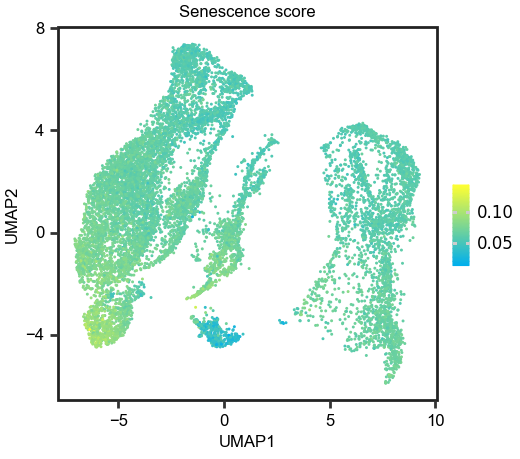

In [61]:
#umap of total dataset


from plotnine import *
import pandas as pd


black = '#222222'
gray = '#666666'
red = '#FF3333'
green = '#66CC00'
blue = '#3333FF'
purple = '#9933FF'
orange = '#FF8000'
yellow = '#FFFF33'
salmen = "#FA8072"
limegreen = '#32CD32'
deepskyblue = '#00AFEE'
c1="#F8766D"
c2="#00BA38"
c3="#619CFF"





embedding = data.obsm["X_umap"]

plot_data=pd.DataFrame(embedding,columns=["UMAP1","UMAP2"])

plot_data["phase"]=phase

plot_data["score"]=score

p =(ggplot()
    + geom_point(plot_data, aes(x='UMAP1', y='UMAP2', color="score"),size=0.001,stroke=0.3,alpha=1)
    #+ geom_point(data_not_indrop, aes(x='UMAP1', y='UMAP2',color="factor(Technology)"),size=0.001,alpha=1)
    +theme(
        figure_size=[2.6,2.3],
        axis_text=element_text(size=6,family="Arial",color="black"),
        axis_title_x=element_text(size=6,family="Arial",color="black"),
        axis_title_y=element_text(size=6,family="Arial",color="black"),
        plot_title=element_text(margin={'b': 1, 'r': 0, 'units': 'pt'},size=6,family="Arial",color="black",hjust=0.5),
        panel_background=element_rect(fill=gray, alpha=0),
        panel_grid_major=element_line(size=0.3, alpha=0.0,color=black),
        panel_grid_minor=element_line(size=0.3, alpha=0.0,color=black),
        panel_border=element_rect(color=black, size=1),
        legend_title = element_text(size=6,alpha=0), #change legend title font size
        legend_text = element_text(size=6),
        legend_background=element_rect(size=0.5,alpha=0),
        #legend_position=(0.75,0.9), 
        legend_direction='vertical',
        #legend_position='right',
        legend_key_size=4) #change legend text font size))
    #+scale_color_manual(values =[c1, c2, c3]) 
    #+geom_density_2d(colour = "#F8766D",size=0.2,data=data_U,alpha=0.5)
    #+geom_density_2d(colour = "#00BA38",size=0.2,data=data_psU,alpha=0.5)
    +ggtitle("Senescence score")
    +scale_color_gradient(low=deepskyblue , high=yellow,mid=c2)
    #+scale_color_gradient(low=purple , high="yellow",mid=c2)
    #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
    #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
   )
#+ facet_wrap('G')
print(p)
p.save('figure/senescence_score_ground_truth.pdf')


In [62]:
#regression model for senescence score

In [63]:
data.X.toarray().shape

(12019, 33538)

In [64]:
import pandas as pd

data=pd.DataFrame(data.X.toarray(),columns=var_names)

data

,MIR1302-2HG,FAM138A,OR4F5,AL627309.1,AL627309.3,AL627309.2,AL627309.4,AL732372.1,OR4F29,AC114498.1,...,AC007325.2,BX072566.1,AL354822.1,AC023491.2,AC004556.1,AC233755.2,AC233755.1,AC240274.1,AC213203.1,FAM231C
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [67]:
data_sparse=data


#statistics of cells expressing each gene
gene_expressed_cell_number=data_sparse.astype(bool).sum(axis=0)

print(len(gene_expressed_cell_number))
#filter gene expressed in less than 10 cells
gene_expressed_cell_number=gene_expressed_cell_number[gene_expressed_cell_number>8000]
print(len(gene_expressed_cell_number))

data_rm_sparse=data_sparse[gene_expressed_cell_number.index.tolist()]
data_rm_sparse.shape           #10k cells, 4487 genes

full_data=data_rm_sparse

33538
3216


In [68]:
base_dir="data/senescent"

In [69]:
import pickle
TF_gene_dict=pickle.load(open("human/TF_gene_dict","rb"))

len(TF_gene_dict)

1209

In [70]:
#generate gene_to_TF_transform_matrix
import numpy as np
import pickle

TF_gene_dict=pickle.load(open("human/TF_gene_dict","rb"))


gene_number=len(data_rm_sparse.columns.to_list())    

TF_number=len(TF_gene_dict)

gene_to_TF_transform_matrix=np.zeros((gene_number,TF_number))

TF_list=TF_gene_dict.keys()
for i,gene in enumerate(data_rm_sparse.columns):
    try:
        j=TF_list.index("gene")
        gene_to_TF_transform_matrix[i][j]=1
    except:
        pass
        
gene_to_TF_transform_matrix

pickle.dump(gene_to_TF_transform_matrix,open("%s/gene_to_TF_transform_matrix" %base_dir,"wb"))

In [71]:
#generate TF_mask

import numpy as np

gene_TF_dict=pickle.load(open("human/gene_TF_dict","rb"))

gene_number = len(data_rm_sparse.columns.to_list())    #6033
TF_number = len(TF_gene_dict)

TF_mask = np.zeros((gene_number,TF_number))
error_count=0

for i,gene_id in enumerate(data_rm_sparse.columns):

    for j,TF in enumerate(TF_gene_dict):
        if TF in gene_TF_dict.get(gene_id,[]):
            TF_mask[i][j]=1
        else:
            error_count+=1
        
print(error_count)
print(TF_mask)

pickle.dump(TF_mask,open("%s/TF_mask" %base_dir,"wb"))

2450918
[[1. 1. 1. ... 0. 0. 0.]
 [1. 0. 1. ... 0. 0. 0.]
 [1. 1. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [72]:
#generate GO_mask

GO_dict={}
with open("human/goa_human.gaf") as f:
    for line in f:
        if line[0] == "!":
            continue
        
        gene_id=line.split("\t")[2]
        GO_term=line.split("\t")[4]
        if GO_term not in GO_dict:
            GO_dict[GO_term]=[]
        GO_dict[GO_term].append(gene_id)


GO_list=[]
count=0
for item in GO_dict:
    if len(GO_dict[item])>=30:
        count+=1
        GO_list.append(item)
print(count)




print("Total GO number:",len(GO_list))




gene_dict={}
with open("human/goa_human.gaf") as f:
    for line in f:
        if line[0]=="!":
            continue
        gene_id=line.split("\t")[2].upper()
        GO_term=line.split("\t")[4]
        if gene_id not in gene_dict:
            gene_dict[gene_id]=[]
        gene_dict[gene_id].append(GO_term)



gene_number=len(data_rm_sparse.columns)    #6033
GO_number=len(GO_list)  

GO_mask=np.zeros((gene_number,GO_number))
error_count=0

for i,gene_id in enumerate(data_rm_sparse.columns):

    for j,GO_term in enumerate(GO_list):
        if GO_term in gene_dict.get(gene_id,"GO:default"):

            GO_mask[i][j]=1
        else:
            error_count+=1
        
print(error_count)

pickle.dump(GO_mask,open("%s/GO_mask" %base_dir,"wb"))


1946
Total GO number: 1946
6214924


In [73]:
#generate GO_TF_mask

TF_number=len(TF_gene_dict)
GO_number=len(GO_list) 

GO_TF_mask=np.zeros((TF_number,GO_number))
error_count=0

for i,TF in enumerate(TF_gene_dict):
    for j,GO in enumerate(GO_list):
        if GO in gene_dict.get(TF,"GO:default"):
            GO_TF_mask[i][j]=1
        else:
            error_count+=1
print(error_count)
        
GO_TF_mask

pickle.dump(GO_TF_mask,open("%s/GO_TF_mask" %base_dir,"wb"))

2332169


In [74]:
meta_data_sene_score

,Unnamed: 0,orig.ident,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT,SCT_snn_res.1.3,seurat_clusters,sen.score
0,AAACGGGAGAGAACAG.1,CreateSeuratObject,34927,5474,AAACGGGAGAGAACAG.1,PDL_25,b'1',WT,0.058550,0.041583,S,2595,2033,1,1,0.058550
1,AAACGGGGTTTAAGCC.1,CreateSeuratObject,35166,5426,AAACGGGGTTTAAGCC.1,PDL_25,b'1',WT,0.062247,0.029044,S,2530,1996,1,1,0.062247
2,AAACGGGTCCTCATTA.1,CreateSeuratObject,36444,5749,AAACGGGTCCTCATTA.1,PDL_25,b'1',WT,0.064165,0.010050,S,2701,2172,11,11,0.064165
3,AAACGGGTCTAAGCCA.1,CreateSeuratObject,67652,6885,AAACGGGTCTAAGCCA.1,PDL_25,b'1',WT,0.076439,-0.123717,S,2297,1797,5,5,0.076439
4,AAACGGGTCTGAGGGA.1,CreateSeuratObject,7680,1920,AAACGGGTCTGAGGGA.1,PDL_25,b'1',WT,0.037590,0.021336,S,3034,1919,12,12,0.037590
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12014,TTTGCGCAGGCTCATT.16,CreateSeuratObject,19265,3947,TTTGCGCAGGCTCATT.16,htert_7,b'16',tert,0.055462,-0.028804,S,2647,1983,7,7,0.055462
12015,TTTGCGCGTGACCAAG.16,CreateSeuratObject,25148,4123,TTTGCGCGTGACCAAG.16,htert_7,b'16',tert,0.068733,-0.084294,S,2718,2086,18,18,0.068733
12016,TTTGCGCGTTAAGATG.16,CreateSeuratObject,32849,5274,TTTGCGCGTTAAGATG.16,htert_7,b'16',tert,0.062875,0.033410,S,2525,1948,7,7,0.062875
12017,TTTGGTTTCTGAAAGA.16,CreateSeuratObject,64737,7046,TTTGGTTTCTGAAAGA.16,htert_7,b'16',tert,0.075287,-0.059841,S,2404,1901,2,2,0.075287


In [77]:
#GO_Net regression model

import math
import time
import numpy as np
import pandas as pd
import pickle
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.autograd import Variable
from sklearn.model_selection import train_test_split as ts

data_rm_sparse=data_rm_sparse

data_rm_sparse.index=(meta_data_sene_score["sen.score"]*100).to_list()

data_rm_sparse.index=data_rm_sparse.index-np.mean((meta_data_sene_score["sen.score"]*100).to_list())

###############################################################
gene_to_TF_transform_matrix=pickle.load(open("%s/gene_to_TF_transform_matrix" %base_dir,"rb"))
TF_mask=pickle.load(open("%s/TF_mask" %base_dir,"rb"))
GO_mask=pickle.load(open("%s/GO_mask" %base_dir,"rb"))
GO_TF_mask=pickle.load(open("%s/GO_TF_mask" %base_dir,"rb"))
###############################################################
#data_annotation = pd.read_csv('data/macparland/GSE115469_CellClusterType.txt', sep="\t")
#index_rename_dict = {key: value for key, value in zip(data_annotation['CellName'], data_annotation['CellType'])}
#$data_rm_sparse=data_rm_sparse.rename(index=index_rename_dict)

#normalize by row
#data_rm_sparse = data_rm_sparse.apply(lambda row: row / np.linalg.norm(row), axis=1)

#merge similar cell types
#data_rm_sparse.index = data_rm_sparse.index.str.replace('Hepatocyte_\d+', 'Hepatocyte', regex=True)
#data_rm_sparse.index = data_rm_sparse.index.str.replace('gamma-delta_T_Cells_\d+', 'gamma-delta_T_Cells', regex=True)


#filter low count cells
#data_rm_sparse = data_rm_sparse[data_rm_sparse.index != 'Hepatic_Stellate_Cells']


#novel_cell_type = ['Plasma_Cells']

#data_rm_sparse_novel = data_rm_sparse[data_rm_sparse.index.isin(novel_cell_type)]
#data_rm_sparse_rest = data_rm_sparse[~data_rm_sparse.index.isin(novel_cell_type)]



""""
classes=[]
for celltype in data_rm_sparse.index:
    if celltype not in classes:
        classes.append(celltype)
#print(len(classes),classes)


label_dict_revese={}
label_dict={}
for i,celltype in enumerate(classes):
    label_dict[celltype]=i
    label_dict_revese[i]=celltype
label_dict
"""
################################################################



def gen_mask(row,col,percent=0.5,num_zeros=None):
    if num_zeros is None:
        #Total number being masked is 0.5 by default
        num_zeros=int((row*col)*percent)
    
    mask=np.hstack([np.zeros(num_zeros),np.ones(row*col-num_zeros)])
    np.random.shuffle(mask)
    return mask.reshape(row,col)

class LinearFunction(torch.autograd.Function):
    """
    autograd function which masks it's weights by 'mask'.
    """
    
    #Not that both forward and backword are @staticmethod

    
    #bias, mask is an optional argument
    @staticmethod
    def forward(ctx, input, weight, bias=None, mask=None):
        if mask is not None:
            #change weight to 0 where mask == 0

            weight=weight*mask
 
        output=input.mm(weight.t())

        if bias is not None:
            output+=bias.unsqueeze(0).expand_as(output)
        
        ctx.save_for_backward(input, weight, bias, mask)

        return output
    
    #This function has noly a single output, so it gets only one gradient
    @staticmethod
    def backward(ctx,grad_output):
        input,weight,bias,mask = ctx.saved_tensors
        grad_input=grad_weight=grad_bias=grad_mask=None
        
        #These meeds_input_grad checks are optional and there only to improve efficiency.
        #If you want to make your code simpler, you can skip them. Returning gradients for
        #inputs that don't require it is not an error.
        if ctx.needs_input_grad[0]:
            grad_input=grad_output.mm(weight)
        
        if ctx.needs_input_grad[1]:
            grad_weight=grad_output.t().mm(input)
            
            if mask is not None:
                
                #change grad_weight to 0 where mask == 0
                grad_weight=grad_weight*mask

        
        #if bias is not None and ctx.need_input_grad[2]:
        if ctx.needs_input_grad[2]:
            grad_bias=grad_output.sum(0).squeeze(0)
        
        return grad_input,grad_weight,grad_bias,grad_mask
    

       
class CustomizedLinear(nn.Module):
    def __init__(self,input_features,output_features, bias=None, mask=None):
        """
        Arguments
        mask [numpy array]:
            The shape is (n_input_fearues,n_output_features).
            The elements are 0 or 1 which delcare un-connected or connected.
            
        bias [bool]:
            flg of bias.
        """
        super(CustomizedLinear,self).__init__()
        self.input_features=input_features
        self.out_features=output_features
        
        #nn.Parameter is a spetial kind of Tensor, that will get
        #automatically registered as Module's parameter once it's assigned
        #as an attribute
        self.weight=nn.Parameter(torch.Tensor(self.out_features,self.input_features))
        
        if bias:

            self.bias=nn.Parameter(torch.Tensor(self.out_features))
        else:
            #You should always register all possible parameters, but the
            #optinal ones can be None if you want.
            self.register_parameter("bias",None)
            
        #Initialize the above parameters (weight and bias). Important!
        self.init_params()
        
        #mask should be registered after weight and bias
        if mask is not None:
            mask=torch.tensor(mask,dtype=torch.float).t()
            self.mask=nn.Parameter(mask,requires_grad=False)
        else:
            self.register_parameter("mask",None)

        
    def init_params(self):
        stdv=1./math.sqrt(self.weight.size(1))
        self.weight.data.uniform_(-stdv,stdv)
        if self.bias is not None:
            self.bias.data.uniform_(-stdv,stdv)
                
    def forward(self,input):
        #See the autograd section for explanation of what happens here.
        
        output=LinearFunction.apply(input,self.weight,self.bias,self.mask)
        
        return output
        
    def extra_repr(self):
        #(Optional) Set the extra informatioin about this module. You can test
        #it by printing an object of this class.
        return "input_features={}, output_features={}, bias={}, mask={}".format(
            self.input_features, self.out_features,
            self.bias is not None, self.mask is not None)
        
        
class GO_Net(nn.Module):
    def __init__(self,in_size,out_size,ratio=[0.006525,0,0]):
        super(GO_Net,self).__init__()

        self.gene_number=len(data_rm_sparse.columns)    #6033
        self.TF_number=1209
        self.GO_number=len(GO_list)
        self.class_number=3

        self.gene_to_TF_transform_matrix=torch.tensor(gene_to_TF_transform_matrix,dtype=torch.float32)
    
        
        self.bn0=nn.BatchNorm1d(self.gene_number)
        #self.fc1=CustomizedLinear(in_size,2290,mask=gen_mask(3443,2290,ratio[0]))  
        #self.fc1=CustomizedLinear(in_size,1946,mask=gen_mask(2903,1946,ratio[0]))        
        self.fc1=CustomizedLinear(in_size,self.GO_number,mask=GO_mask)    #GO_term
        self.gene_to_GO_layer=CustomizedLinear(in_size,self.GO_number,mask=GO_mask)    #GO_term
        #self.fc1=CustomizedLinear(in_size,2290,mask=np.ones((3443,2290)))
    
        self.bn1=nn.BatchNorm1d(self.GO_number)
                
        self.fc2=CustomizedLinear(self.GO_number,out_size,mask=gen_mask(self.GO_number,out_size,ratio[1]))
        self.bn2=nn.BatchNorm1d(out_size)

        self.gene_to_TF_layer=CustomizedLinear(self.gene_number,self.TF_number,mask=TF_mask)
        self.TF_to_GO_layer=CustomizedLinear(self.TF_number,self.GO_number,mask=GO_TF_mask)
        
        self.fc3=CustomizedLinear(100,100,mask=gen_mask(100,100,ratio[1]))

        self.fc4=CustomizedLinear(100,out_size,mask=gen_mask(100,out_size,ratio[1]))
        
        self.relu=nn.ReLU()
        self.leaky_relu=nn.LeakyReLU()
        #self.dropout = nn.Dropout(0.1)
        for module in self.modules():
            if isinstance(module,nn.Linear):
                nn.init.uniform_(module.weight,a=0,b=1)
            elif isinstance(module,(nn.BatchNorm1d,nn.GroupNorm)):
                nn.init.constant_(module.weight,1)
                nn.init.constant_(module.bias,0)

                        
    def forward(self,x):
        
        #x=self.bn0(x)
        
        TF_residul=torch.matmul(x,self.gene_to_TF_transform_matrix)
        
 
        TF_derived_from_gene=self.gene_to_TF_layer(x)

        
        TF_sum=TF_residul+TF_derived_from_gene
        #TF_sum=TF_derived_from_gene

        GO_derived_from_TF=self.TF_to_GO_layer(TF_sum)

        GO_derived_from_gene=self.gene_to_GO_layer(x)

        GO_sum=GO_derived_from_TF+GO_derived_from_gene
        
        
        #x=self.bn0(x)
        #x=self.fc1(x)
        #x=self.bn1(x)
        #x=self.relu(x)
        #x=self.dropout(x)
        GO_sum=self.leaky_relu(GO_sum)

        #x=torch.tanh(x) 
        #print(161,self.fc1.weight)
        x=self.fc2(GO_sum)
        #x=self.bn2(x)
        #x=self.relu(x)
        #x=self.leaky_relu(x)
        #x=self.fc3(x)
        #x=self.leaky_relu(x)
        #x=self.fc4(x)
        

        return x,GO_sum,TF_derived_from_gene,GO_derived_from_TF

"""
class Reconstraction(nn.Module):
    def __init__(self,in_size,out_size):
        super(Reconstraction,self).__init__()

        self.decoder = nn.Sequential(
            nn.Linear(in_size, 500),
            nn.LeakyReLU(True),
            nn.Linear(500, 500),
            nn.LeakyReLU(True),
            nn.Linear(500, 500),
            nn.LeakyReLU(True),
            nn.Linear(500, 1000),
            nn.LeakyReLU(True),
            nn.Linear(1000, out_size)
        )

    def forward(self, x):
        x = self.decoder(x)
        return x
"""     


 
class MyDataset(Dataset):
    def __init__(self, x,y):
        self.x=x
        self.y=y

    def __getitem__(self, index):
        features = self.x[index]
        label = self.y[index]
        return features, label

    def __len__(self):
        return len(self.x)

def accuracy_score(y_test,y_pred):
    t=0
    f=0
    for i in range(len(y_test)):
        if y_test[i]==y_pred[i]:
            t+=1
        else:
            f+=1
    return(t/(t+f))



from torch.utils.data import WeightedRandomSampler

def make_weights_for_balanced_classes(dataset, nclasses):
    count = [0] * nclasses
    for item in dataset:
        count[item[1]] += 1
    weight_per_class = [0.] * nclasses
    N = float(sum(count))
    for i in range(nclasses):
        weight_per_class[i] = N/float(count[i])
    weight = [0] * len(dataset)
    for idx, val in enumerate(dataset):
        weight[idx] = weight_per_class[val[1]]
    return weight


class CustomWeightedRandomSampler(WeightedRandomSampler):
    """WeightedRandomSampler except allows for more than 2^24 samples to be sampled"""
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

    def __iter__(self):
        rand_tensor = np.random.choice(range(0, len(self.weights)),
                                       size=self.num_samples,
                                       p=self.weights.numpy() / torch.sum(self.weights).numpy(),
                                       replace=self.replacement)
        rand_tensor = torch.from_numpy(rand_tensor)
        return iter(rand_tensor.tolist())





#training
input_size = len(data_rm_sparse.columns)
#output_size = len(classes)
output_size = 1


learning_rate = 0.1
epochs = 3


#reconstraction_optimizer = optim.Adam(reconstraction_model.parameters(), lr=0.001)

#criterion = nn.CrossEntropyLoss()
criterion = nn.MSELoss()
#reconstraction_criterion = nn.MSELoss()



data_train_x=data_rm_sparse
data_train_y=data_rm_sparse.index


#5-fold cross validation
import numpy as np
from sklearn.model_selection import KFold

num_folds = 5

# Generate 5-fold cross-validation indices
kf = KFold(n_splits=num_folds, shuffle=True)
fold_indices = list(kf.split(data_rm_sparse))

# Perform 5-fold cross-validation
for fold, (train_indices, test_indices) in enumerate(fold_indices, start=1):

    #define model and optimizer
    model = GO_Net(input_size, output_size,ratio=[0,0,0])
    optimizer = optim.Adam(model.parameters(), lr=0.01)


    # Subset data and annotation based on indices
    x_train = data_train_x.iloc[train_indices].to_numpy()
    y_train = data_train_y[train_indices,]
    
    x_test = data_train_x.iloc[test_indices].to_numpy()
    y_test = data_train_y[test_indices,]

    # Continue with your operations on data_train, anno_train, data_test, and anno_test




    #x_train,x_test,y_train,y_test = ts(data_train_x.to_numpy(),data_train_y.to_numpy(),test_size=0.2,random_state=1, shuffle=True)

    #x_train=x_train[0:400]
    #y_train=y_train[0:400]

    #label_dict={25:0,26:1,27:2,33:3,34:4}
    #y_train_relabeled=[label_dict[label] for label in y_train]
    #y_test_relabeled=[label_dict[label] for label in y_test]


    #train_size=20000

    #x_train=x_train[0:train_size]
    #y_train_relabeled=y_train_relabeled[0:train_size]

    train_data=MyDataset(x_train,y_train)



    #for unbalanced data
    """
    weights=make_weights_for_balanced_classes(train_data,len(classes))
    weights = torch.DoubleTensor(weights)
    sampler = CustomWeightedRandomSampler(weights, len(weights))        #sampler for imbalanced classes
    """

    #train_loader=DataLoader(train_data, batch_size=60, sampler=sampler)
    train_loader=DataLoader(train_data, batch_size=8, shuffle=True,num_workers=10)

    num_epochs=15
    # 训练模型
    for epoch in range(num_epochs):
        tic=time.time()
        running_loss = 0.0
        reconstraction_running_loss = 0.0

        for i, batch in enumerate(train_loader, 0):
            inputs, labels = batch
            #print(labels)
            inputs=Variable(inputs).to(torch.float32)
            labels=Variable(labels).to(torch.float32)
            # 将梯度缓存清零
            optimizer.zero_grad()

            # 前向传播、计算损失和反向传播
            outputs,_,_,_ = model(inputs)
            outputs=outputs.squeeze()
            loss = criterion(outputs, labels)

            #reconstraction_input=reconstraction_model(outputs)
            #reconstraction_loss = reconstraction_criterion(reconstraction_input, inputs)

            #reconstraction_optimizer.zero_grad()

            #combined_loss=loss+reconstraction_loss
            #combined_loss.backward()
            loss.backward()
        
            optimizer.step()
            #reconstraction_optimizer.step()


            #reconstraction_running_loss += reconstraction_loss.item()
            running_loss += loss.item()

            if i % 40 == 0:
                pass
                #print(i)
                #print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss / 200))
            
            if i>40:
                break

        test_data=MyDataset(x_test,y_test)
        test_loader=DataLoader(test_data, batch_size=32, shuffle=False,num_workers=10)
        result=[]
        test_loss=0
        for i, batch in enumerate(test_loader):
            inputs, labels = batch
            
            inputs=Variable(inputs).to(torch.float32)

            labels=Variable(labels).to(torch.float32)
            
            outputs,_,_,_ = model(inputs)
            outputs=outputs.squeeze()
            loss = criterion(outputs, labels)
            #pred = list(torch.max(outputs, 1)[1].numpy())
            #result.extend(pred)
            #print(pred,labels)
            test_loss += loss.item()
            if i>100:
                break
        #accuracy = accuracy_score(y_test_relabeled[0:len(result)],result)
        #f1_score = calculate_multiclass_f1_score(y_test_relabeled[0:len(result)],result)
                ##### ####

        toc=time.time()
        print("fold %s-%s" %(fold,epoch),"\tloss:\t",running_loss / 400," \ttest_loss:\t",test_loss /100 , "\ttime:\t", toc-tic )
        
        #save model
        #pickle.dump(model,open("model/GO_heart.model","wb"))
    break        
        


fold 1-0 	loss:	 0.8270824690163135  	test_loss:	 1.4362499797344208 	time:	 5.108247518539429
fold 1-1 	loss:	 0.075164292473346  	test_loss:	 0.3326530881226063 	time:	 4.832137107849121
fold 1-2 	loss:	 0.047140922714024786  	test_loss:	 0.28748410269618035 	time:	 5.026251792907715
fold 1-3 	loss:	 0.03400047110393643  	test_loss:	 0.205361083522439 	time:	 5.578589916229248
fold 1-4 	loss:	 0.026352034471929072  	test_loss:	 0.1860751773416996 	time:	 4.883665084838867
fold 1-5 	loss:	 0.025361960148438813  	test_loss:	 0.7117303508520126 	time:	 5.705825567245483
fold 1-6 	loss:	 0.026631295289844273  	test_loss:	 0.18609337329864503 	time:	 4.9822678565979
fold 1-7 	loss:	 0.031755544333718716  	test_loss:	 0.18922880321741103 	time:	 5.913514137268066
fold 1-8 	loss:	 0.030491436794400216  	test_loss:	 0.5192724704742432 	time:	 5.49923849105835
fold 1-9 	loss:	 0.03444879295304418  	test_loss:	 0.18683399982750415 	time:	 5.071852922439575
fold 1-10 	loss:	 0.02474000653252005

KeyboardInterrupt: 

In [78]:

test_data=MyDataset(x_test,y_test)
test_loader=DataLoader(test_data, batch_size=32, shuffle=False)
result=[]
test_loss=0
senescence_score_ground_truth=[]
senescence_score_prediction=[]
for i, batch in enumerate(test_loader):
    inputs, labels = batch
            
    inputs=Variable(inputs).to(torch.float32)

    labels=Variable(labels).to(torch.float32)

    outputs,_,_,_ = model(inputs)

    loss = criterion(outputs, labels)

    senescence_score_ground_truth.extend(list(labels.detach().numpy()))
    senescence_score_prediction.extend(list(outputs.detach().numpy()))
    #pred = list(torch.max(outputs, 1)[1].numpy())
    #result.extend(pred)
    #print(pred,labels)
    test_loss += loss.item()
    if i>200:
        break
#accuracy = accuracy_score(y_test_relabeled[0:len(result)],result)
#f1_score = calculate_multiclass_f1_score(y_test_relabeled[0:len(result)],result)
                #########

toc=time.time()
print("fold %s-%s" %(fold,epoch),"\tloss:\t",running_loss / len(train_loader)," \ttest_loss:\t",test_loss, "\ttime:\t", toc-tic )
        
#save model

fold 1-13 	loss:	 0.005112901528345765  	test_loss:	 108.32510828971863 	time:	 7.746973991394043


In [79]:
senescence_score_prediction = [list(i)[0] for i in senescence_score_prediction]

In [80]:
senescence_score_prediction

[-2.3997188,
 -0.5359023,
 -0.89224297,
 -0.8048199,
 -0.7388319,
 0.19777314,
 0.8694303,
 -0.25791582,
 -0.04319562,
 -0.7361427,
 0.36782736,
 -1.7660174,
 -0.38990328,
 0.6352621,
 -0.49910414,
 -0.6505403,
 0.26889357,
 -0.9024891,
 0.1977241,
 -0.25158396,
 -0.17827158,
 0.06832758,
 0.19974479,
 -0.6031264,
 -0.70358247,
 -2.1277003,
 -0.13058284,
 -0.28288135,
 0.10186768,
 -0.4584755,
 -0.60728014,
 0.57536626,
 0.4023716,
 -0.6936297,
 0.59889036,
 -0.30818987,
 -0.22082345,
 -0.2714456,
 -0.28062284,
 -0.804291,
 -1.0093478,
 -0.39692974,
 0.61179864,
 -0.51119524,
 -1.0816075,
 -0.8874471,
 -1.0572625,
 0.4053875,
 -0.48873496,
 -0.6732116,
 0.73153424,
 -0.39581785,
 -0.03136492,
 -1.0998235,
 -0.4094231,
 0.12758702,
 -0.9646396,
 -0.4317693,
 -0.23749247,
 -2.6605496,
 -0.20983352,
 0.19509453,
 -0.38620356,
 0.09965112,
 0.3106644,
 -0.64686435,
 -0.92015415,
 -0.5306695,
 -1.1090599,
 -0.6565803,
 -0.41270876,
 -0.4353736,
 -0.27228463,
 0.26238245,
 -0.113050565,
 -1.

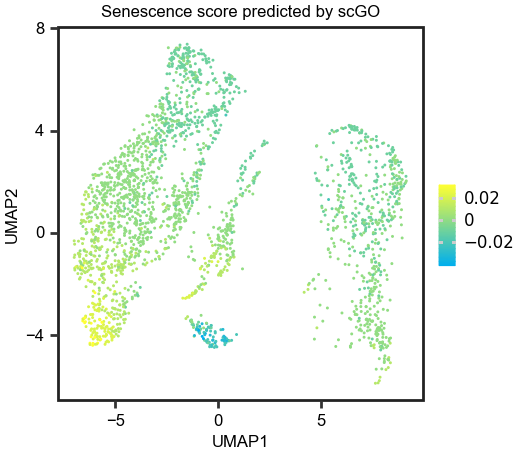

In [83]:
#umap of test dataset


from plotnine import *
import pandas as pd


black = '#222222'
gray = '#666666'
red = '#FF3333'
green = '#66CC00'
blue = '#3333FF'
purple = '#9933FF'
orange = '#FF8000'
yellow = '#FFFF33'
salmen = "#FA8072"
limegreen = '#32CD32'
deepskyblue = '#00AFEE'
c1="#F8766D"
c2="#00BA38"
c3="#619CFF"





embedding = data.obsm["X_umap"]

plot_data=pd.DataFrame(embedding,columns=["UMAP1","UMAP2"])


plot_data=plot_data.iloc[test_indices]
#plot_data["phase"]=phase

plot_data["score"]=senescence_score_prediction

plot_data["score"]/=100

plot_data["score"]=round(plot_data["score"],2)

p =(ggplot()
    + geom_point(plot_data, aes(x='UMAP1', y='UMAP2', color="score"),size=0.001,stroke=0.3,alpha=1)
    #+ geom_point(data_not_indrop, aes(x='UMAP1', y='UMAP2',color="factor(Technology)"),size=0.001,alpha=1)
    +theme(
        figure_size=[2.6,2.3],
        axis_text=element_text(size=6,family="Arial",color="black"),
        axis_title_x=element_text(size=6,family="Arial",color="black"),
        axis_title_y=element_text(size=6,family="Arial",color="black"),
        plot_title=element_text(margin={'b': 1, 'r': 0, 'units': 'pt'},size=6,family="Arial",color="black",hjust=0.5),
        panel_background=element_rect(fill=gray, alpha=0),
        panel_grid_major=element_line(size=0.3, alpha=0.0,color=black),
        panel_grid_minor=element_line(size=0.3, alpha=0.0,color=black),
        panel_border=element_rect(color=black, size=1),
        legend_title = element_text(size=6,alpha=0), #change legend title font size
        legend_text = element_text(size=6),
        legend_background=element_rect(size=0.5,alpha=0),
        #legend_position=(0.75,0.9), 
        legend_direction='vertical',
        #legend_position='right',
        legend_key_size=4) #change legend text font size))
    #+scale_color_manual(values =[c1, c2, c3]) 
    #+geom_density_2d(colour = "#F8766D",size=0.2,data=data_U,alpha=0.5)
    #+geom_density_2d(colour = "#00BA38",size=0.2,data=data_psU,alpha=0.5)
    +ggtitle("Senescence score predicted by scGO")
    +scale_color_gradient(low=deepskyblue , high=yellow,mid=c2)
    #+scale_color_gradient(low=purple , high="yellow",mid=c2)
    #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
    #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
   )
#+ facet_wrap('G')
print(p)
p.save('figure/senescence_score_prediction.pdf')


In [26]:
plot_data

,UMAP1,UMAP2,score
0,-1.104083,5.806268,-0.01
17,-4.514604,2.605772,0.00
18,-0.603197,-3.748971,-0.01
44,-1.375487,4.410628,-0.01
48,-1.549525,6.887432,-0.00
...,...,...,...
11994,8.100310,-4.761662,0.01
12004,7.987379,-4.690764,0.00
12005,6.737090,3.451495,-0.01
12012,6.878716,-4.191599,-0.00


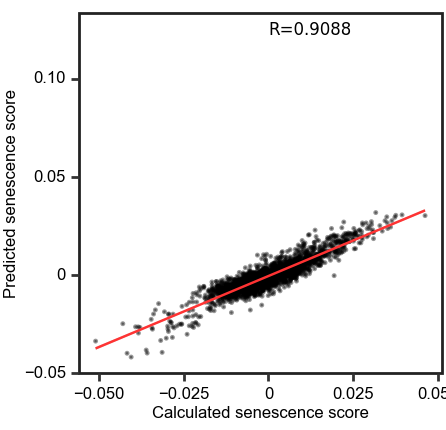

In [84]:
#scatter plot
import scipy

plot_data=pd.DataFrame({"senescence_socre_ground_truth":senescence_score_ground_truth,"senescence_socre_prediction":senescence_score_prediction})

plot_data["senescence_socre_ground_truth"]/=100
plot_data["senescence_socre_prediction"]/=100

r,p=scipy.stats.pearsonr(plot_data["senescence_socre_ground_truth"],plot_data["senescence_socre_prediction"])
p_text="R={:.4f}".format(r)


p=(
    ggplot(plot_data,aes(x="senescence_socre_ground_truth",y="senescence_socre_prediction"))
    +geom_point(plot_data,aes(x="senescence_socre_ground_truth",y="senescence_socre_prediction"),size=0.001,alpha=0.4,stroke=0.5)   
    #+geom_smooth(method="lm",color="#F8766D",size=0.5)
    +geom_smooth(method="lm",color=red,size=0.5)
    +annotate("text",x=0,y=0.125,label=p_text,ha="left",size=6,color="black")
    #+scale_x_continuous(breaks = [0,100,200,300],labels =["               5'UTR", "                CDS", "                3'UTR",""])
    +theme(panel_background=element_rect(fill=gray, alpha=0),
            strip_text_x = element_text(size = 6),            #facet font size
            legend_position = "none",
            panel_grid_major=element_line(size=0.3, alpha=0,color=black),
            panel_grid_minor=element_line(size=0.3, alpha=0,color=black),
            panel_border=element_rect(color=black, size=1),
            axis_text=element_text(size=6,family="Arial",color="black"),
            axis_title_x=element_text(size=6,family="Arial",color="black"),
            axis_title_y=element_text(size=6,family="Arial",color="black"),
           
            figure_size=[2.23,2.15],
            legend_title = element_text(size=6), #change legend title font size
            legend_text = element_text(size=6),
            legend_background=element_rect(size=0.5,alpha=0),
            #legend_position=(0.45,0.4), 
            legend_key_size=12) #change legend text font size)
    #+ geom_vline(xintercept=100,linetype="dashed",alpha=0.5)
    #+ geom_vline(xintercept=200,linetype="dashed",alpha=0.5)
    #+ylim([0,0.15])
    #+xlim([0,0.15])
    +scale_fill_manual(values=[c1, c2, c3]) 
    #+stat_smooth(method='lm',color="black")
    +labs(x="Calculated senescence score",y="Predicted senescence score")

)

print(p)
p.save('figure/senescence_score_correlation.pdf')

In [85]:
PDL=meta_data.iloc[test_indices]["PDL"].to_list()
PDL

['PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',
 'PDL_25',

In [86]:
['htert_2','htert_7','PDL_25', 'PDL_29', 'PDL_33', 'PDL_37', 'PDL_46', 'PDL_50']

['htert_2',
 'htert_7',
 'PDL_25',
 'PDL_29',
 'PDL_33',
 'PDL_37',
 'PDL_46',
 'PDL_50']

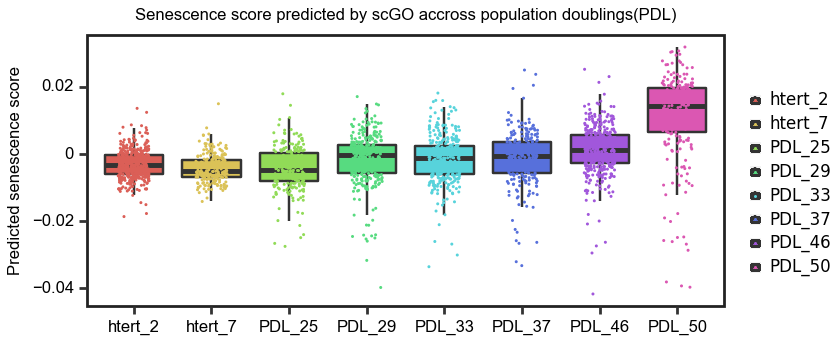

In [87]:
#violinplot for each stage

#umap of test dataset


from plotnine import *
import pandas as pd


black = '#222222'
gray = '#666666'
red = '#FF3333'
green = '#66CC00'
blue = '#3333FF'
purple = '#9933FF'
orange = '#FF8000'
yellow = '#FFFF33'
salmen = "#FA8072"
limegreen = '#32CD32'
deepskyblue = '#00AFEE'
c1="#F8766D"
c2="#00BA38"
c3="#619CFF"





embedding = data.obsm["X_umap"]

plot_data=pd.DataFrame(embedding,columns=["UMAP1","UMAP2"])


plot_data=plot_data.iloc[test_indices]
#plot_data["phase"]=phase

plot_data["score"]=senescence_score_prediction

plot_data["score"]/=100

#plot_data["score"]=round(plot_data["score"],2)

plot_data["PDL"]=PDL


#reorder 
plot_data['PDL'] = pd.Categorical(plot_data['PDL'], categories=['htert_2','htert_7','PDL_25', 'PDL_29', 'PDL_33', 'PDL_37', 'PDL_46', 'PDL_50'])

p =(ggplot()
    #+ geom_point(plot_data, aes(x='UMAP1', y='UMAP2', color="score"),size=0.001,stroke=0.3,alpha=1)
    +geom_boxplot(plot_data,aes(x="PDL",y="score",fill="PDL"),outlier_shape="") 
    #+geom_violin(plot_data,aes(x="PDL",y="score")) 
    +geom_jitter(plot_data,aes(x="PDL",y="score",fill="PDL",color="PDL"),width=0.2, height=0, alpha=1,size=0.01,stroke=0.3) 
    
    #+ geom_point(data_not_indrop, aes(x='UMAP1', y='UMAP2',color="factor(Technology)"),size=0.001,alpha=1)
    +theme(
        figure_size=[4.2,1.8],
        axis_text=element_text(size=6,family="Arial",color="black"),
        axis_title_x=element_text(size=6,family="Arial",color="black"),
        axis_title_y=element_text(size=6,family="Arial",color="black"),
        plot_title=element_text(margin={'b': 1, 'r': 0, 'units': 'pt'},size=6,family="Arial",color="black",hjust=0.5),
        panel_background=element_rect(fill=gray, alpha=0),
        panel_grid_major=element_line(size=0.3, alpha=0.0,color=black),
        panel_grid_minor=element_line(size=0.3, alpha=0.0,color=black),
        panel_border=element_rect(color=black, size=1),
        legend_title = element_text(size=6,alpha=0), #change legend title font size
        legend_text = element_text(size=6),
        legend_background=element_rect(size=0.5,alpha=0),
        #legend_position=(0.75,0.9), 
        legend_direction='vertical',
        #legend_position='right',
        legend_key_size=4) #change legend text font size))
    #+scale_color_manual(values =[c1, c2, c3]) 
    #+geom_density_2d(colour = "#F8766D",size=0.2,data=data_U,alpha=0.5)
    #+geom_density_2d(colour = "#00BA38",size=0.2,data=data_psU,alpha=0.5)
    +ggtitle("Senescence score predicted by scGO accross population doublings(PDL)")
    #+scale_color_gradient(low=deepskyblue , high=yellow,mid=c2)
    #+scale_color_gradient(low=purple , high="yellow",mid=c2)
    #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
    #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
    +labs(x="",y="Predicted senescence score")
   )
#+ facet_wrap('G')
print(p)
p.save('figure/senescence_score_prediction_with_PDL.pdf')



In [31]:
#cell phase proprotion accross predicted senescence scores.


In [32]:
test_meta_data=meta_data.iloc[test_indices]

test_meta_data["predicted_senescence_score"]=senescence_score_prediction

test_meta_data["predicted_senescence_score"]/=100

test_meta_data

/tmp/ipykernel_34484/402603009.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_34484/402603009.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT,predicted_senescence_score
AAACGGGAGAGAACAG.1,34927.0,5474,AAACGGGAGAGAACAG.1,PDL_25,b'1',WT,0.541781,0.209151,S,35623.0,5474,-0.007051
AACACGTTCGGTCTAA.1,34264.0,5082,AACACGTTCGGTCTAA.1,PDL_25,b'1',WT,-0.127019,-0.348735,G1,35520.0,5082,0.001397
AACCATGCAACTTGAC.1,14261.0,2172,AACCATGCAACTTGAC.1,PDL_25,b'1',WT,-0.056473,-0.172473,G1,34454.0,3244,-0.013861
AAGGCAGCAAACTGCT.1,27931.0,4821,AAGGCAGCAAACTGCT.1,PDL_25,b'1',WT,0.178095,0.569511,G2M,34742.0,4821,-0.008473
AAGTCTGCACGTCAGC.1,33321.0,5493,AAGTCTGCACGTCAGC.1,PDL_25,b'1',WT,0.367277,0.370641,G2M,35259.0,5493,-0.004908
...,...,...,...,...,...,...,...,...,...,...,...,...
TTGGAACGTGTAATGA.16,47906.0,5755,TTGGAACGTGTAATGA.16,htert_7,b'16',tert,-0.158952,-0.407866,G1,37234.0,5738,0.006254
TTTACTGAGAGTACCG.16,53466.0,5975,TTTACTGAGAGTACCG.16,htert_7,b'16',tert,-0.169864,-0.210460,G1,37034.0,5792,0.003402
TTTACTGAGCCCAACC.16,66263.0,6662,TTTACTGAGCCCAACC.16,htert_7,b'16',tert,0.019930,1.007521,G2M,37658.0,5852,-0.007315
TTTCCTCCACTGAAGG.16,34454.0,4448,TTTCCTCCACTGAAGG.16,htert_7,b'16',tert,-0.182110,-0.320925,G1,35655.0,4448,-0.000463


In [33]:
test_meta_data["score_range"]=test_meta_data["PDL"]

for i in test_meta_data.index:
    #test_meta_data.at[i,"score_range"]="b"
    senescence_score = test_meta_data.at[i,"predicted_senescence_score"]

    if senescence_score<0.04:
        test_meta_data.at[i,"score_range"]="<0.04"
    elif senescence_score>=0.04 and senescence_score<=0.05:
        test_meta_data.at[i,"score_range"]="0.04-0.05"
    elif senescence_score>=0.05 and senescence_score<=0.06:
        test_meta_data.at[i,"score_range"]="0.05-0.06"
    elif senescence_score>=0.06 and senescence_score<=0.07:
        test_meta_data.at[i,"score_range"]="0.06-0.07"
    elif senescence_score>=0.07 and senescence_score<=0.08:
        test_meta_data.at[i,"score_range"]="0.07-0.08"
    elif senescence_score>=0.08 and senescence_score<=0.09:
        test_meta_data.at[i,"score_range"]="0.08-0.09"
    elif senescence_score>=0.09 and senescence_score<=0.10:
        test_meta_data.at[i,"score_range"]="0.09-0.10"
    elif senescence_score>=0.10:
        test_meta_data.at[i,"score_range"]=">0.10"

    
test_meta_data    



/tmp/ipykernel_34484/2344154035.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT,predicted_senescence_score,score_range
AAACGGGAGAGAACAG.1,34927.0,5474,AAACGGGAGAGAACAG.1,PDL_25,b'1',WT,0.541781,0.209151,S,35623.0,5474,-0.007051,<0.04
AACACGTTCGGTCTAA.1,34264.0,5082,AACACGTTCGGTCTAA.1,PDL_25,b'1',WT,-0.127019,-0.348735,G1,35520.0,5082,0.001397,<0.04
AACCATGCAACTTGAC.1,14261.0,2172,AACCATGCAACTTGAC.1,PDL_25,b'1',WT,-0.056473,-0.172473,G1,34454.0,3244,-0.013861,<0.04
AAGGCAGCAAACTGCT.1,27931.0,4821,AAGGCAGCAAACTGCT.1,PDL_25,b'1',WT,0.178095,0.569511,G2M,34742.0,4821,-0.008473,<0.04
AAGTCTGCACGTCAGC.1,33321.0,5493,AAGTCTGCACGTCAGC.1,PDL_25,b'1',WT,0.367277,0.370641,G2M,35259.0,5493,-0.004908,<0.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGGAACGTGTAATGA.16,47906.0,5755,TTGGAACGTGTAATGA.16,htert_7,b'16',tert,-0.158952,-0.407866,G1,37234.0,5738,0.006254,<0.04
TTTACTGAGAGTACCG.16,53466.0,5975,TTTACTGAGAGTACCG.16,htert_7,b'16',tert,-0.169864,-0.210460,G1,37034.0,5792,0.003402,<0.04
TTTACTGAGCCCAACC.16,66263.0,6662,TTTACTGAGCCCAACC.16,htert_7,b'16',tert,0.019930,1.007521,G2M,37658.0,5852,-0.007315,<0.04
TTTCCTCCACTGAAGG.16,34454.0,4448,TTTCCTCCACTGAAGG.16,htert_7,b'16',tert,-0.182110,-0.320925,G1,35655.0,4448,-0.000463,<0.04


In [36]:
score_range=["<0.04","0.04-0.05","0.05-0.06","0.06-0.07","0.07-0.08","0.08-0.09","0.09-0.10",">0.10"]*3
phase=["G1","G2M","S"]*8

import numpy as np

count_matrix=pd.DataFrame(np.zeros((8,3)),index=["<0.04","0.04-0.05","0.05-0.06","0.06-0.07","0.07-0.08","0.08-0.09","0.09-0.10",">0.10"],columns=["G1","G2M","S"])

print(count_matrix)

for i in range(len(test_meta_data)):
    score_range=test_meta_data.iloc[i]["score_range"]
    phase=test_meta_data.iloc[i]["Phase"]

    count_matrix.at[score_range,phase]+=1

print(count_matrix)

count_matrix_normalized = count_matrix.div(count_matrix.sum(axis=1), axis=0)

count_matrix_normalized

            G1  G2M    S
<0.04      0.0  0.0  0.0
0.04-0.05  0.0  0.0  0.0
0.05-0.06  0.0  0.0  0.0
0.06-0.07  0.0  0.0  0.0
0.07-0.08  0.0  0.0  0.0
0.08-0.09  0.0  0.0  0.0
0.09-0.10  0.0  0.0  0.0
>0.10      0.0  0.0  0.0
               G1    G2M      S
<0.04      1472.0  523.0  406.0
0.04-0.05     2.0    0.0    0.0
0.05-0.06     1.0    0.0    0.0
0.06-0.07     0.0    0.0    0.0
0.07-0.08     0.0    0.0    0.0
0.08-0.09     0.0    0.0    0.0
0.09-0.10     0.0    0.0    0.0
>0.10         0.0    0.0    0.0


,G1,G2M,S
<0.04,0.613078,0.217826,0.169096
0.04-0.05,1.000000,0.000000,0.000000
0.05-0.06,1.000000,0.000000,0.000000
0.06-0.07,NaN,NaN,NaN
0.07-0.08,NaN,NaN,NaN
0.08-0.09,NaN,NaN,NaN
0.09-0.10,NaN,NaN,NaN
>0.10,NaN,NaN,NaN


In [37]:
score_range=["<0.04","0.04-0.05","0.05-0.06","0.06-0.07","0.07-0.08","0.08-0.09","0.09-0.10",">0.10"]*3
phase=["G1","G2M","S"]*8

proportion=[0]*len(phase)

for i in range(len(phase)):
    proportion[i]=count_matrix_normalized.at[score_range[i],phase[i]]

proportion

[0.6130778842149105,
 0.0,
 0.0,
 nan,
 nan,
 nan,
 nan,
 nan,
 0.16909620991253643,
 1.0,
 0.0,
 nan,
 nan,
 nan,
 nan,
 nan,
 0.2178259058725531,
 0.0,
 1.0,
 nan,
 nan,
 nan,
 nan,
 nan]

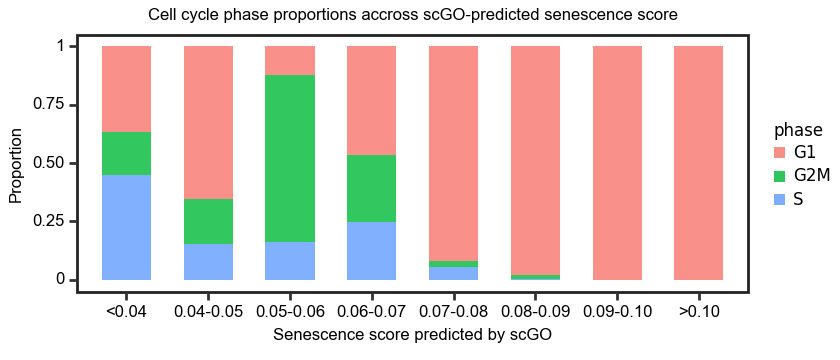

/home/wuyou/.conda/envs/sc/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 4.2 x 1.8 in image.
/home/wuyou/.conda/envs/sc/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: figure/cell_phase_proportions_accross_senescence_score.pdf


In [256]:
#

import pandas as pd
from plotnine import *
import numpy as np

black = '#222222'
gray = '#666666'
red = '#FF3333'
green = '#66CC00'
blue = '#3333FF'
purple = '#9933FF'
orange = '#FF8000'
yellow = '#FFFF33'

c1="#F8766D"
c2="#00BA38"
c3="#619CFF"


plot_data=pd.DataFrame(dict(score_range=score_range,phase=phase,proportion=proportion))

["<0.04","0.04-0.05","0.05-0.06","0.06-0.07","0.07-0.08","0.08-0.09","0.09-0.10",">0.10"]
plot_data['score_range'] = pd.Categorical(plot_data['score_range'], categories=["<0.04","0.04-0.05","0.05-0.06","0.06-0.07","0.07-0.08","0.08-0.09","0.09-0.10",">0.10"])

p1 = (ggplot()
        +geom_bar(plot_data,aes(x="score_range",y="proportion",fill="phase"),stat="identity",position="stack",width=0.6,alpha=0.8)
        +scale_fill_manual(values=[c1,c2,c3])
        +theme(panel_background=element_rect(fill=gray, alpha=0),
            panel_grid_major=element_line(size=0.3, alpha=0.0,color=black),
            panel_grid_minor=element_line(size=0.3, alpha=0.0,color=black),
            panel_border=element_rect(color=black, size=1),
            axis_text=element_text(size=6,family="Arial",color="black"),
            axis_title_x=element_text(size=6,family="Arial",color="black"),
            axis_title_y=element_text(size=6,family="Arial",color="black"),
            
            #axis_text_x=element_text(rotation=45, hjust=0.5),
            figure_size=[4.2,1.8],
            legend_title = element_text(size=6), #change legend title font size
            legend_text = element_text(size=6),
            legend_background=element_rect(size=0.5,alpha=0),
            #legend_position=(0.60,0.4),
               
            plot_title=element_text(margin={'b': 1, 'r': 0, 'units': 'pt'},size=6,family="Arial",color="black",hjust=0.5),
            
            legend_position=None,
            legend_key_size=4) #change legend text font size
        +labs(x = "Senescence score predicted by scGO", y ="Proportion")
        +guides(color = guide_legend(title = "Phase"))
        + ggtitle("Cell cycle phase proportions accross scGO-predicted senescence score")
    )
print(p1)
p1.save('figure/cell_phase_proportions_accross_senescence_score.pdf')


# in silico gene perturbation 

In [ ]:
#in silico deletion 

In [106]:
import torch.nn.functional as F
import warnings

# Suppress all warnings
warnings.filterwarnings("ignore")

gene_list=data_rm_sparse.columns.tolist()

data_rm_sparse_subset=pd.DataFrame(columns=gene_list)


data_rm_sparse.index=(meta_data_sene_score["sen.score"]*100).to_list()
data_rm_sparse.index=data_rm_sparse.index-np.mean((meta_data_sene_score["sen.score"]*100).to_list())       #zero


data_rm_sparse_subset=data_rm_sparse.sample(n=1000,random_state=1)



x_test=data_rm_sparse_subset.to_numpy()
y_test=data_rm_sparse_subset.index.tolist()



test_data=MyDataset(x_test,y_test)
test_loader=DataLoader(test_data, batch_size=1000, shuffle=False)
result=[]
y_prob=[]
y_test=[]
for i, data in enumerate(test_loader):
    inputs, labels = data
            
    inputs=Variable(inputs).to(torch.float32)

    labels=Variable(labels).to(torch.long)
            
    outputs,_,_,_ = model(inputs)    #x,GO_sum,TF_derived_from_gene,GO_derived_from_TF
    #pred = list(torch.max(outputs, 1)[1].numpy())
    #result.extend(pred)

    y_predict_origin=outputs.squeeze().detach().numpy()
            




def compare_prob(y_predict_origin,y_predict_shift):
    """
    y_prob_softmax_origin: the original softmax probability
    y_prob_softmax_shift: the shifted softmax probability
    """

    #statistic the number of cells that have increased probability for each class
    score_increase = sum(y_predict_origin<y_predict_shift)
    score_decrease = sum(y_predict_origin>y_predict_shift)

    return score_increase,score_decrease


#select index=="normal"
#N_to_H_KD_dict={}
#N_to_D_KD_dict={}
KD_increase_dict={}
KD_decrease_dict={}

for i in range(len(data_rm_sparse_subset.columns)):

    if i%500==0:
        print(i)

    data_rm_sparse_subset_copy=data_rm_sparse_subset.copy()

    data_rm_sparse_subset_copy.iloc[:,i] = data_rm_sparse_subset_copy.iloc[:,i]*0.5

    #model=pickle.load(open("model/GO_heart.model","rb"))



    x_test=data_rm_sparse_subset_copy.to_numpy()
    y_test=data_rm_sparse_subset_copy.index.tolist()



    test_data=MyDataset(x_test,y_test)
    test_loader=DataLoader(test_data, batch_size=1000, shuffle=False)
    result=[]
    y_prob=[]
    y_test=[]
    for j, data in enumerate(test_loader):
        inputs, labels = data
            
        inputs=Variable(inputs).to(torch.float32)

        labels=Variable(labels).to(torch.long)
            
        outputs,_,_,_ = model(inputs)    #x,GO_sum,TF_derived_from_gene,GO_derived_from_TF
        #pred = list(torch.max(outputs, 1)[1].numpy())
        #result.extend(pred)
  
            
        y_predict_shift=outputs.squeeze().detach().numpy()

        #y_prob_softmax_shift=F.softmax(torch.tensor(y_prob),dim=1)

        score_increase,score_decrease=compare_prob(y_predict_origin,y_predict_shift)


        KD_increase_dict[data_rm_sparse_subset.columns[i]]=score_increase
        KD_decrease_dict[data_rm_sparse_subset.columns[i]]=score_decrease
  

0
500
1000
1500
2000
2500
3000


In [121]:
import pickle

pickle.dump(KD_increase_dict,open("data/senescent/KD_increase_dict","wb"))
pickle.dump(KD_decrease_dict,open("data/senescent/KD_decrease_dict","wb"))


In [175]:
KD_decrease_dict


S1=sorted(KD_increase_dict, key=lambda k: KD_increase_dict[k], reverse=True)[:100]
S2=sorted(KD_decrease_dict, key=lambda k: KD_decrease_dict[k], reverse=True)[:100]

In [144]:
for gene in S1:
    print(gene)

RPL22
RPL11
SH3BGRL3
NDUFS5
YBX1
RPS8
UQCRH
S100A10
S100A11
S100A6
S100A13
RPS27
MGST3
GUK1
RPS7
RPS27A
TMSB10
RPL31
DBI
EEF1B2
RPL37A
PTMA
RPL32
RPL15
RPSA
RPL14
RPL29
RPL24
RPL35A
RPL9
RPL34
RPS3A
RPL37
BTF3
TBCA
RPS23
COX7C
HINT1
UQCRQ
SKP1
RPS14
NPM1
ATP6V0E1
RPS18
CUTA
RPL10A
EEF1A1
COX7A2
SNX3
RPS12
ACTB
NDUFA4
PPIA
SEC61G
CHCHD2
HSPB1
TMSB4X
RPS4X
BEX3
RPL39
RPL10
RPS20
RPL7
UQCRB
RPL30
COX6C
PABPC1
EEF1D
RPL8
RPS6
TPM2
TXN
RPL35
RPL12
RPL7A
PHPT1
EDF1
RPLP2
EIF3F
RPL27A
RPS13
FTH1
PRDX5
FAU
CFL1
RPS3
ATP5MG
RPS25
RPS24
GAPDH
PFDN5
RPS26
RPL41
MYL6
NACA
NAP1L1
C12orf75
RPL6
RPLP0
COX6A1
RPL21
NEDD8
RPS29
RPL36AL
HSP90AA1
ATP5MPL
NOP10
SRP14
SERF2
ANXA2
TPM1
RPS27L
RPL4
RPLP1
RPS17
RPS2
ELOB
RPS15A
MT2A
HSBP1
COX4I1
RPL13
PFN1
RPL26
RPL23A
RPL23
RPL19
EIF1
RPL27
RPL38
ACTG1
MYL12A
MYL12B
DSTN
MYL9
ATP5F1E
RPS21
PPDPF
GPX4
RPS15
OAZ1
RPL36
RPS28
UBL5
WDR83OS
C19orf53
RPL18A
UBA52
COX6B1
RPS16
RPS19
SNRPD2
AP2S1
RPL18
FTL
RPL13A
RPS11
RPS9
RPL28
RPS5
LGALS1
RPL3
ATP5PF
ATP5IF1
RPL5

In [152]:
x_test

array([[0.26943472027778625, 0.0, 0.0, ..., 0.26943472027778625,
        2.722893476486206, 'PDL_33'],
       [0.2155287116765976, 0.5432266592979431, 0.78963303565979, ...,
        0.2155287116765976, 3.1717495918273926, 'PDL_29'],
       [0.4683520495891571, 0.0, 0.585828959941864, ...,
        0.33521413803100586, 2.886207103729248, 'PDL_29'],
       ...,
       [0.0, 0.0, 0.46851593255996704, ..., 0.26144903898239136,
        3.0166468620300293, 'PDL_37'],
       [0.0, 0.0, 0.6604322195053101, ..., 0.0, 2.7103428840637207,
        'PDL_25'],
       [0.0, 0.0, 0.5805317759513855, ..., 0.2329588085412979,
        2.83333683013916, 'PDL_29']], dtype=object)

In [ ]:
#in silico activation

In [88]:
import torch.nn.functional as F
import warnings

# Suppress all warnings
warnings.filterwarnings("ignore")

gene_list=data_rm_sparse.columns.tolist()

data_rm_sparse_subset=pd.DataFrame(columns=gene_list)

data_rm_sparse.index=(meta_data_sene_score["sen.score"]*100).to_list()


data_rm_sparse.index=data_rm_sparse.index-np.mean((meta_data_sene_score["sen.score"]*100).to_list())       #zero

data_rm_sparse_subset=data_rm_sparse.sample(n=1000,random_state=1)



x_test=data_rm_sparse_subset.to_numpy()
y_test=data_rm_sparse_subset.index.tolist()



test_data=MyDataset(x_test,y_test)
test_loader=DataLoader(test_data, batch_size=1000, shuffle=False)
result=[]
y_prob=[]
y_test=[]
for i, data in enumerate(test_loader):
    inputs, labels = data
            
    inputs=Variable(inputs).to(torch.float32)

    labels=Variable(labels).to(torch.long)
            
    outputs,_,_,_ = model(inputs)    #x,GO_sum,TF_derived_from_gene,GO_derived_from_TF
    #pred = list(torch.max(outputs, 1)[1].numpy())
    #result.extend(pred)

    y_predict_origin=outputs.squeeze().detach().numpy()
            




def compare_prob(y_predict_origin,y_predict_shift):
    """
    y_prob_softmax_origin: the original softmax probability
    y_prob_softmax_shift: the shifted softmax probability
    """

    #statistic the number of cells that have increased probability for each class
    score_increase = sum(y_predict_origin<y_predict_shift)
    score_decrease = sum(y_predict_origin>y_predict_shift)

    return score_increase,score_decrease


#select index=="normal"
#N_to_H_KD_dict={}
#N_to_D_KD_dict={}
OE_increase_dict={}
OE_decrease_dict={}

for i in range(len(data_rm_sparse_subset.columns)):

    if i%500==0:
        print(i)


    data_rm_sparse_subset_copy=data_rm_sparse_subset.copy()
    data_rm_sparse_subset_copy.iloc[:,i] = data_rm_sparse_subset_copy.iloc[:,i]*1.01

    #model=pickle.load(open("model/GO_heart.model","rb"))



    x_test=data_rm_sparse_subset_copy.to_numpy()
    y_test=data_rm_sparse_subset_copy.index.tolist()



    test_data=MyDataset(x_test,y_test)
    test_loader=DataLoader(test_data, batch_size=1000, shuffle=False)
    result=[]
    y_prob=[]
    y_test=[]
    for j, data in enumerate(test_loader):
        inputs, labels = data
            
        inputs=Variable(inputs).to(torch.float32)

        labels=Variable(labels).to(torch.long)
            
        outputs,_,_,_ = model(inputs)    #x,GO_sum,TF_derived_from_gene,GO_derived_from_TF
        #pred = list(torch.max(outputs, 1)[1].numpy())
        #result.extend(pred)
  
            
        y_predict_shift=outputs.squeeze().detach().numpy()

        #y_prob_softmax_shift=F.softmax(torch.tensor(y_prob),dim=1)

        score_increase,score_decrease=compare_prob(y_predict_origin,y_predict_shift)


        OE_increase_dict[data_rm_sparse_subset.columns[i]]=score_increase
        OE_decrease_dict[data_rm_sparse_subset.columns[i]]=score_decrease
  

0
500
1000
1500
2000
2500
3000


In [120]:
import pickle

pickle.dump(OE_increase_dict,open("data/senescent/OE_increase_dict","wb"))
pickle.dump(OE_decrease_dict,open("data/senescent/OE_decrease_dict","wb"))

In [176]:
S3=sorted(OE_increase_dict, key=lambda k: OE_increase_dict[k], reverse=True)[:100]
S4=sorted(OE_decrease_dict, key=lambda k: OE_decrease_dict[k], reverse=True)[:100]

In [146]:
for gene in S3:
    print(gene)

VIM
ARF4
AP2M1
REXO2
TPI1
PRDX6
UCHL1
CALD1
PTMS
GABARAPL2
TXNDC17
LMNA
CAPN2
SNHG8
RAC1
YWHAZ
VDAC2
PGAM1
LARP6
CNN3
RTN4
LDHA
PRR13
HNRNPC
STUB1
MT-CO1
BNIP3
EID1
NDUFB10
RAB5C
PSMA7
ARF1
HNRNPA2B1
PSMB7
ARPC3
YWHAB
CCDC85B
MT-CO2
PEA15
SPCS1
HSP90AB1
PRDX2
CYB5R3
UBE2D3
PERP
CD44
GAS6
NDUFAB1
COTL1
NDUFV2
MYDGF
MT-ND4
BZW1
VDAC1
CLTB
NDUFB9
CD151
LGALS3
VKORC1
CAVIN1
RPS19BP1
CAPZA1
SELENOT
BRI3
RAB2A
ASPH
NDUFB8
SNF8
BSG
CALR
RABAC1
TMED9
AP1S1
PPA1
STRAP
TMED2
TMEM147
MT-ND1
SSR2
PCBP1
POLE4
WDR1
GTF3C6
CST3
JTB
TUBA1A
PSMB6
EIF3G
FKBP8
TTC3
RAB34
KRT10
UQCRFS1
C1orf43
SBDS
TRAM1
FKBP2
EI24
PPIB
EIF5A
EIF2S2
RAB1A
MRPL36
SRI
YIF1A
TMBIM6
SRSF9
TBCB
MT-ND2
MT-ND3
TIMM17A
PDIA6
CAST
HEBP2
CNPY2
DEF8
P4HB
YWHAQ
BUD31
GNB2
DKK3
TNFRSF12A
RER1
PTP4A2
MRFAP1
CAV2
AHNAK
ANAPC16
PPP4C
ATP6V0B
ADI1
LAPTM4A
CANX
PSMB1
FLNA
VTI1B
SEC62
MTDH
CD63
IGFBP4
MT-ATP6
PNKD
GNAI2
ARL6IP5
EIF4A2
CCNG1
IGFBP6
SCP2
CD164
ANXA11
HSP90B1
FAM177A1
OAZ2
COL1A2
GHITM
MT-ND5
BASP1
PDLIM2
PAPOLA
GNAS
CCDC50
CA

In [162]:
print(len(S1))

400


In [177]:
def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3


S1_S4=intersection(S1,S4)
S2_S3=intersection(S2,S3)
len(S1_S4+S2_S3)

199

In [187]:
#OE or KD shift normal to dilated
#S5+S6+S7+S8



gene_list=S1_S4[:80]+S2_S3[:80]

import pickle
TF_gene_dict=pickle.load(open("human/TF_gene_dict","rb"))

#build the formula from TF_gene_dict
formula=[]
for gene in gene_list:
    
    if gene in TF_gene_dict:
        target_gene_list = TF_gene_dict[gene]

        for target_gene in target_gene_list:
            if target_gene in gene_list:
                #print("%s->%s" % (gene, target_gene))
                formula.append("%s->%s" % (gene, target_gene))


#find the maximum linked set
def find_maximum_linked_set(linked_nodes_list):
    graph = {}
    
    # Build the graph from the linked nodes list
    for link in linked_nodes_list:
        src, dest = link.split('->')
        graph.setdefault(src, set()).add(dest)
        graph.setdefault(dest, set()).add(src)
    
    def dfs(node, visited):
        visited.add(node)
        for neighbor in graph[node]:
            if neighbor not in visited:
                dfs(neighbor, visited)

    max_linked_set = []
    for node in graph:
        visited = set()
        dfs(node, visited)
        if len(visited) > len(max_linked_set):
            max_linked_set = list(visited)

    return max_linked_set


# Example linked nodes list
linked_nodes_list = formula

# Find the maximum set of nodes that are linked together
maximum_subset = find_maximum_linked_set(linked_nodes_list)


#set parameters
gene_relation=[]
color_dict={}
for i,gene in enumerate(maximum_subset):
    if gene in TF_gene_dict:
        color_dict[gene]="lightgreen"
        target_gene_list = TF_gene_dict[gene]

        for target_gene in target_gene_list:
            if target_gene in maximum_subset:
                j=maximum_subset.index(target_gene)
                gene_relation.append("%s->%s" % (i, j))

formula=",".join(gene_relation)

color_list=[]



#split by ',' or '->', use re
import re
re.split(',|->',formula)


names=[]
indice=re.split(',|->',formula)
for index in indice:
    index=int(index)
    if maximum_subset[index] not in names:
        names.append(maximum_subset[index])


color_list
for gene in names:
    color_list.append(color_dict.get(gene,"lightblue"))

#example
import igraph as ig
import matplotlib.pyplot as plt

g = ig.Graph.Formula(
    formula,
)

node_names = maximum_subset
g.vs['name'] = names



articulation_points = g.vs[g.articulation_points()]

fig, ax = plt.subplots()
ig.plot(
    g,
    target=ax,
    vertex_size=0.5,
    bbox=(1800, 1800),
    vertex_frame_width=0,
    #vertex_color="lightblue",
    vertex_color=color_list,
    #vertex_label=range(g.vcount()),
    vertex_label=g.vs["name"],
    vertex_label_size=3,
    #vertex_frame_color = ["red" if v in articulation_points else "black" for v in g.vs],
    #vertex_frame_width = [2 if v in articulation_points else 1 for v in g.vs],
    edge_width=0.5,
    edge_color='gray',

)
#plt.show()
plt.savefig('figure/igraph_senescence_associated_genes.pdf', dpi=1200,format='pdf')

In [172]:
len(node_names)

317

In [96]:

data_rm_sparse


,NOC2L,HES4,ISG15,AGRN,SDF4,B3GALT6,UBE2J2,ACAP3,PUSL1,INTS11,...,MT-CO1,MT-CO2,MT-ATP6,MT-CO3,MT-ND3,MT-ND4L,MT-ND4,MT-ND5,MT-ND6,MT-CYB
5.855048,0.620003,0.00000,0.452745,0.452745,0.888532,0.000000,0.452745,0.452745,0.251779,0.452745,...,4.117600,3.928254,2.651150,3.454274,1.817038,0.888532,3.687337,1.769394,0.452745,2.868243
6.224709,0.450267,0.00000,0.759619,0.450267,0.450267,0.000000,0.250265,0.000000,0.250265,0.000000,...,4.160899,3.960245,3.105815,3.474454,1.605654,1.417798,3.550752,1.417798,0.000000,2.939957
6.416493,0.242470,0.24247,0.740782,0.000000,1.161634,0.000000,0.437472,0.000000,0.437472,0.242470,...,4.531759,4.262262,3.318402,3.767150,2.061766,1.161634,3.760787,1.684601,0.242470,2.935748
7.643942,0.137860,0.13786,0.137860,0.367033,0.907513,0.258997,0.258997,0.553354,0.258997,0.258997,...,4.816556,4.655956,3.285407,4.167604,2.127132,0.965450,3.852663,1.995524,0.000000,2.930545
3.759016,0.833815,0.00000,1.282091,0.000000,0.833815,0.000000,0.000000,0.000000,0.000000,0.000000,...,3.196119,2.810908,0.833815,1.825892,0.833815,1.282091,2.313978,0.000000,0.000000,1.590510
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5.546235,0.712044,0.00000,0.000000,0.000000,0.418102,0.000000,0.418102,0.000000,0.418102,0.000000,...,3.786081,3.605939,3.031335,2.897541,1.735486,1.279650,2.519282,1.533319,0.000000,2.519282
6.873280,0.785242,0.00000,0.585168,0.334789,0.000000,0.000000,0.785242,0.334789,0.334789,0.334789,...,3.933851,3.972019,2.754482,3.319346,1.819601,0.785242,2.754482,1.430591,0.000000,2.938848
6.287506,0.265761,0.00000,0.475517,0.265761,0.648814,0.000000,0.796467,0.265761,0.265761,0.000000,...,4.196465,4.254314,2.973989,3.680387,2.315768,1.039053,3.313634,1.600902,0.265761,2.973989
7.528697,0.143642,0.00000,0.269219,0.269219,0.992949,0.380772,0.655875,0.269219,0.143642,0.143642,...,4.238102,5.097780,3.018636,3.728723,1.408404,0.481120,3.509721,1.369899,0.143642,2.614958


In [97]:
meta_data

,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT
AAACGGGAGAGAACAG.1,34927.0,5474,AAACGGGAGAGAACAG.1,PDL_25,b'1',WT,0.541781,0.209151,S,35623.0,5474
AAACGGGGTTTAAGCC.1,35166.0,5426,AAACGGGGTTTAAGCC.1,PDL_25,b'1',WT,0.404641,0.513172,G2M,35723.0,5426
AAACGGGTCCTCATTA.1,36444.0,5749,AAACGGGTCCTCATTA.1,PDL_25,b'1',WT,-0.009645,0.473208,G2M,36291.0,5748
AAACGGGTCTAAGCCA.1,67652.0,6885,AAACGGGTCTAAGCCA.1,PDL_25,b'1',WT,-0.272565,-0.505199,G1,37575.0,6022
AAACGGGTCTGAGGGA.1,7680.0,1920,AAACGGGTCTGAGGGA.1,PDL_25,b'1',WT,0.347032,0.027671,S,32182.0,4066
...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCAGGCTCATT.16,19265.0,3947,TTTGCGCAGGCTCATT.16,htert_7,b'16',tert,0.244858,-0.206021,S,34455.0,4143
TTTGCGCGTGACCAAG.16,25148.0,4123,TTTGCGCGTGACCAAG.16,htert_7,b'16',tert,-0.163569,-0.256886,G1,34817.0,4137
TTTGCGCGTTAAGATG.16,32849.0,5274,TTTGCGCGTTAAGATG.16,htert_7,b'16',tert,0.482551,0.123422,S,35182.0,5274
TTTGGTTTCTGAAAGA.16,64737.0,7046,TTTGGTTTCTGAAAGA.16,htert_7,b'16',tert,-0.094765,0.148554,G2M,37665.0,6365


In [214]:
meta_data

,nCount_RNA,nFeature_RNA,barcode,PDL,sample,exp,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT
AAACGGGAGAGAACAG.1,34927.0,5474,AAACGGGAGAGAACAG.1,PDL_25,b'1',WT,0.541781,0.209151,S,35623.0,5474
AAACGGGGTTTAAGCC.1,35166.0,5426,AAACGGGGTTTAAGCC.1,PDL_25,b'1',WT,0.404641,0.513172,G2M,35723.0,5426
AAACGGGTCCTCATTA.1,36444.0,5749,AAACGGGTCCTCATTA.1,PDL_25,b'1',WT,-0.009645,0.473208,G2M,36291.0,5748
AAACGGGTCTAAGCCA.1,67652.0,6885,AAACGGGTCTAAGCCA.1,PDL_25,b'1',WT,-0.272565,-0.505199,G1,37575.0,6022
AAACGGGTCTGAGGGA.1,7680.0,1920,AAACGGGTCTGAGGGA.1,PDL_25,b'1',WT,0.347032,0.027671,S,32182.0,4066
...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCAGGCTCATT.16,19265.0,3947,TTTGCGCAGGCTCATT.16,htert_7,b'16',tert,0.244858,-0.206021,S,34455.0,4143
TTTGCGCGTGACCAAG.16,25148.0,4123,TTTGCGCGTGACCAAG.16,htert_7,b'16',tert,-0.163569,-0.256886,G1,34817.0,4137
TTTGCGCGTTAAGATG.16,32849.0,5274,TTTGCGCGTTAAGATG.16,htert_7,b'16',tert,0.482551,0.123422,S,35182.0,5274
TTTGGTTTCTGAAAGA.16,64737.0,7046,TTTGGTTTCTGAAAGA.16,htert_7,b'16',tert,-0.094765,0.148554,G2M,37665.0,6365


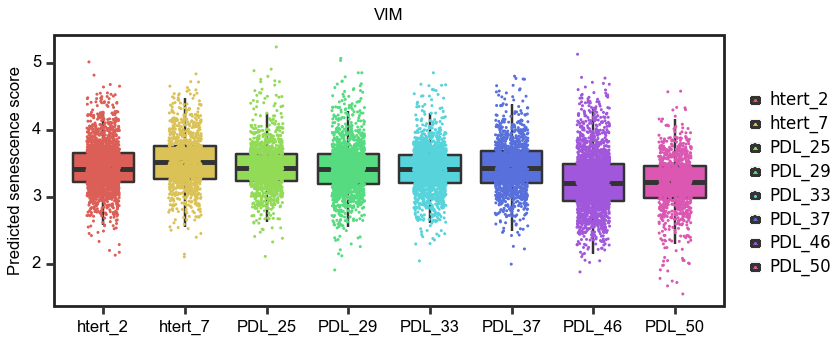

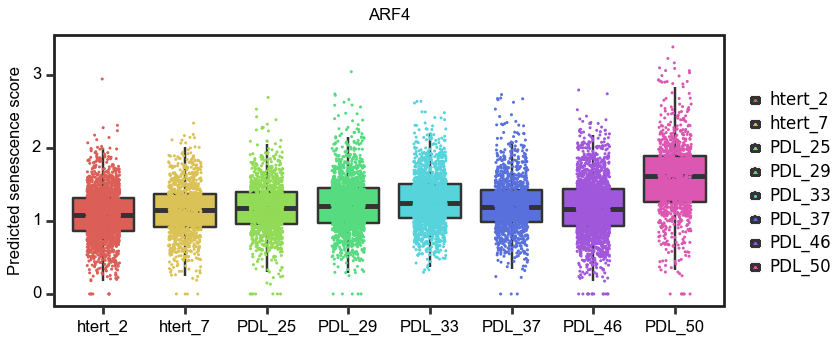

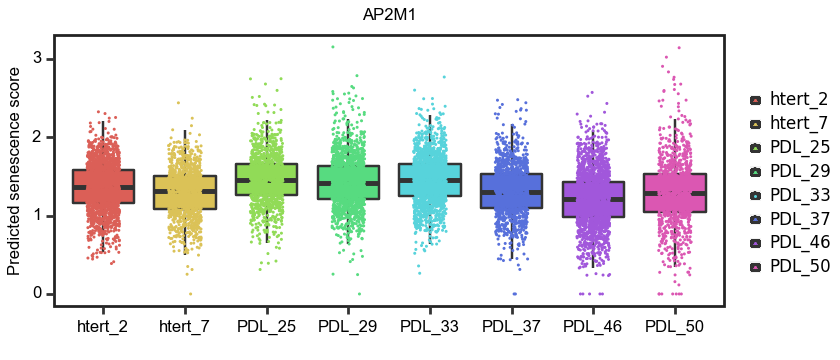

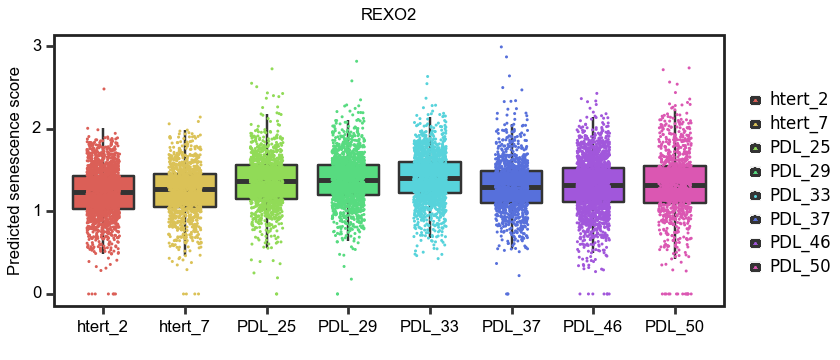

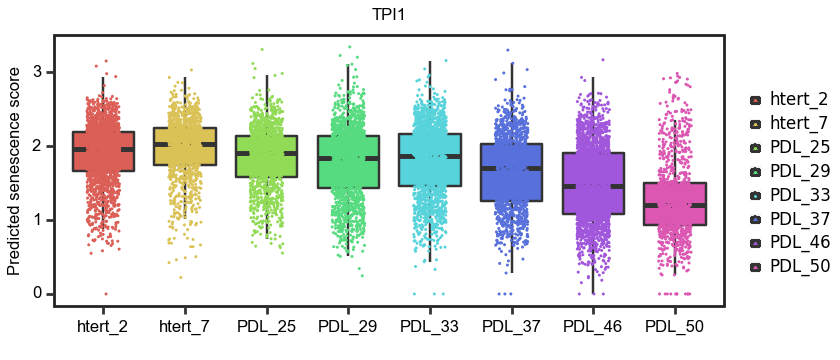

...

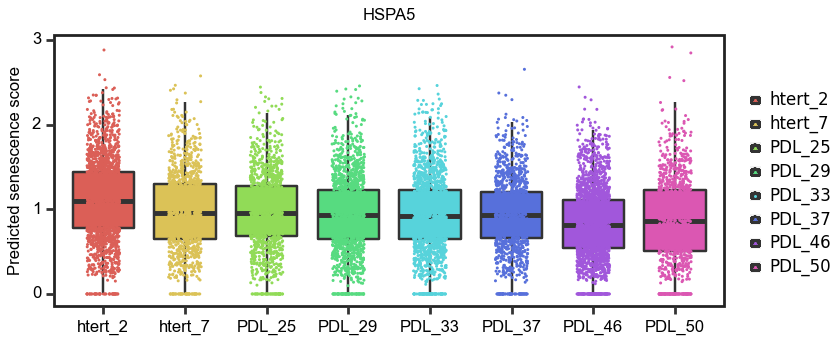

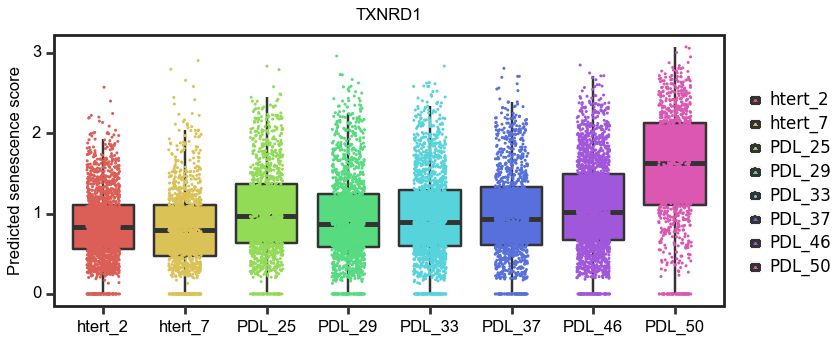

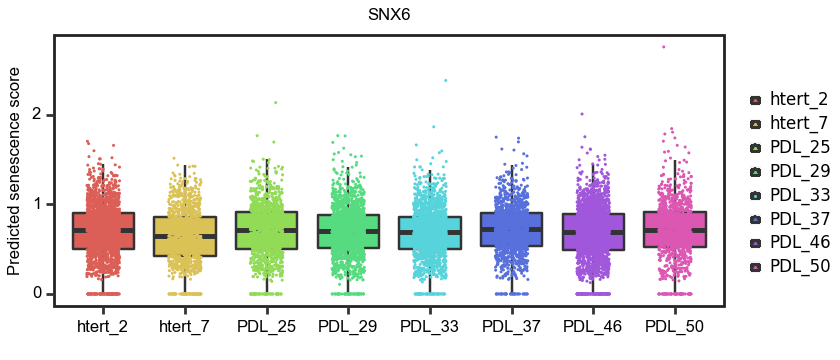

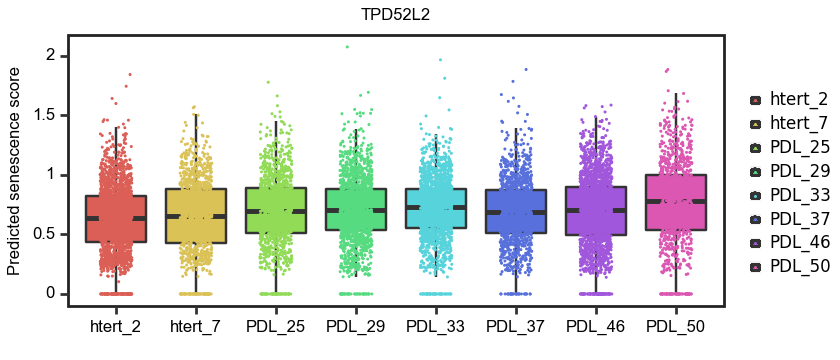

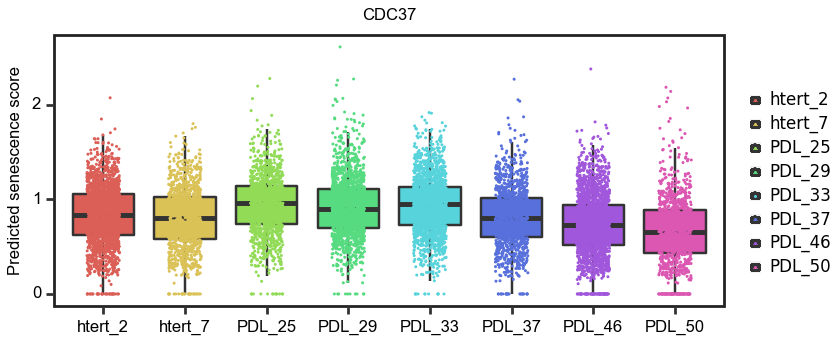

KeyboardInterrupt: 

In [139]:
#violinplot for each stage

#umap of test dataset


from plotnine import *
import pandas as pd


black = '#222222'
gray = '#666666'
red = '#FF3333'
green = '#66CC00'
blue = '#3333FF'
purple = '#9933FF'
orange = '#FF8000'
yellow = '#FFFF33'
salmen = "#FA8072"
limegreen = '#32CD32'
deepskyblue = '#00AFEE'
c1="#F8766D"
c2="#00BA38"
c3="#619CFF"


meta_data["score_range"]=meta_data["PDL"]
meta_data["sen.score"]=meta_data_sene_score["sen.score"].to_list()


for i in meta_data.index:
    #test_meta_data.at[i,"score_range"]="b"
    senescence_score = meta_data.at[i,"sen.score"]

    if senescence_score<0.04:
        meta_data.at[i,"score_range"]="<0.04"
    elif senescence_score>=0.04 and senescence_score<=0.05:
        meta_data.at[i,"score_range"]="0.04-0.05"
    elif senescence_score>=0.05 and senescence_score<=0.06:
        meta_data.at[i,"score_range"]="0.05-0.06"
    elif senescence_score>=0.06 and senescence_score<=0.07:
        meta_data.at[i,"score_range"]="0.06-0.07"
    elif senescence_score>=0.07 and senescence_score<=0.08:
        meta_data.at[i,"score_range"]="0.07-0.08"
    elif senescence_score>=0.08 and senescence_score<=0.09:
        meta_data.at[i,"score_range"]="0.08-0.09"
    elif senescence_score>=0.09 and senescence_score<=0.10:
        meta_data.at[i,"score_range"]="0.09-0.10"
    elif senescence_score>=0.10:
        meta_data.at[i,"score_range"]=">0.10"

    



#embedding = data.obsm["X_umap"]

plot_data=data_rm_sparse.copy()        #copy to create a new object



plot_data["PDL"]=meta_data["PDL"].to_list()
plot_data["score_range"]=meta_data["score_range"].to_list()

for gene in S3:


    #reorder 
    plot_data['PDL'] = pd.Categorical(plot_data['PDL'], categories=['htert_2','htert_7','PDL_25', 'PDL_29', 'PDL_33', 'PDL_37', 'PDL_46', 'PDL_50'])

    p =(ggplot()
        #+ geom_point(plot_data, aes(x='UMAP1', y='UMAP2', color="score"),size=0.001,stroke=0.3,alpha=1)
        +geom_boxplot(plot_data,aes(x="PDL", y=gene, fill="PDL"),outlier_shape="") 
        #+geom_violin(plot_data,aes(x="PDL",y="score")) 
        +geom_jitter(plot_data,aes(x="PDL", y=gene, fill="PDL",color="PDL"),width=0.2, height=0, alpha=1,size=0.01,stroke=0.3) 

        #+ geom_point(data_not_indrop, aes(x='UMAP1', y='UMAP2',color="factor(Technology)"),size=0.001,alpha=1)
        +theme(
            figure_size=[4.2,1.8],
            axis_text=element_text(size=6,family="Arial",color="black"),
            axis_title_x=element_text(size=6,family="Arial",color="black"),
            axis_title_y=element_text(size=6,family="Arial",color="black"),
            plot_title=element_text(margin={'b': 1, 'r': 0, 'units': 'pt'},size=6,family="Arial",color="black",hjust=0.5),
            panel_background=element_rect(fill=gray, alpha=0),
            panel_grid_major=element_line(size=0.3, alpha=0.0,color=black),
            panel_grid_minor=element_line(size=0.3, alpha=0.0,color=black),
            panel_border=element_rect(color=black, size=1),
            legend_title = element_text(size=6,alpha=0), #change legend title font size
            legend_text = element_text(size=6),
            legend_background=element_rect(size=0.5,alpha=0),
            #legend_position=(0.75,0.9), 
            legend_direction='vertical',
            #legend_position='right',
            legend_key_size=4) #change legend text font size))
        #+scale_color_manual(values =[c1, c2, c3]) 
        #+geom_density_2d(colour = "#F8766D",size=0.2,data=data_U,alpha=0.5)
        #+geom_density_2d(colour = "#00BA38",size=0.2,data=data_psU,alpha=0.5)
        +ggtitle(gene)
        #+scale_color_gradient(low=deepskyblue , high=yellow,mid=c2)
        #+scale_color_gradient(low=purple , high="yellow",mid=c2)
        #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
        #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
        +labs(x="",y="Predicted senescence score")
       )
    #+ facet_wrap('G')
    print(p)
    #p.save('figure/senescence_score_prediction_with_PDL.pdf')



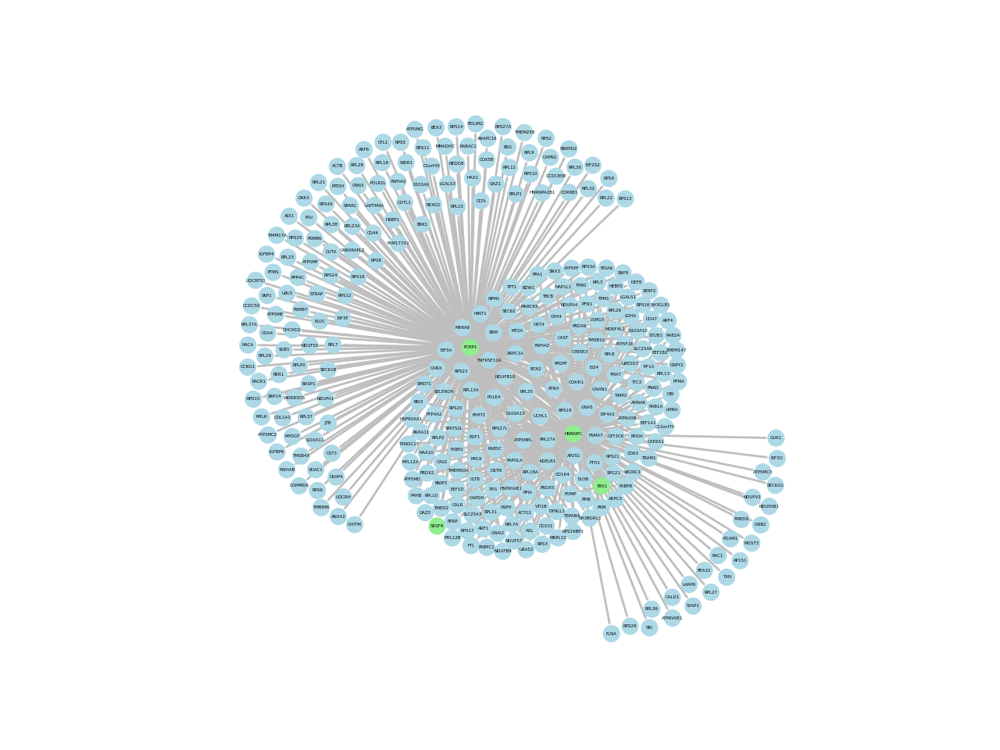

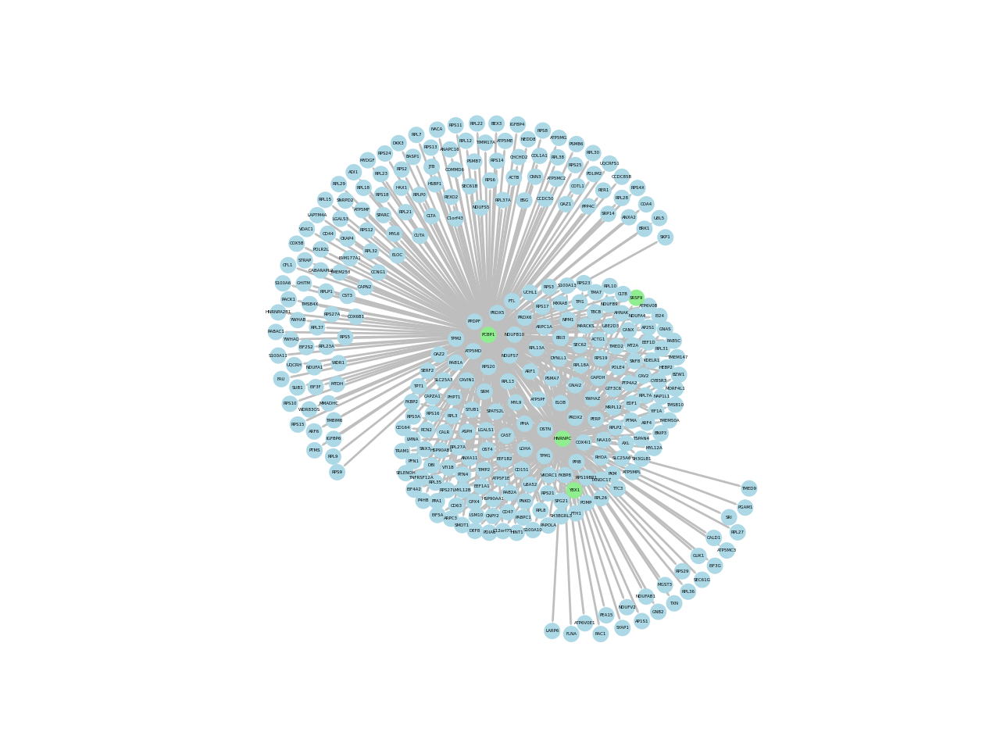

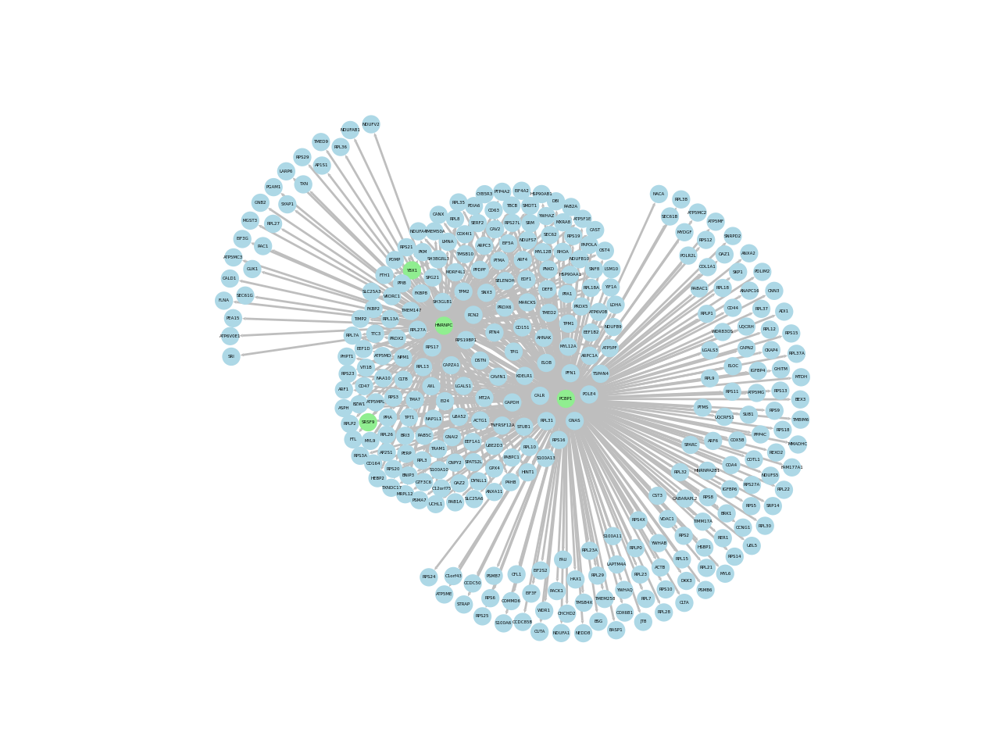

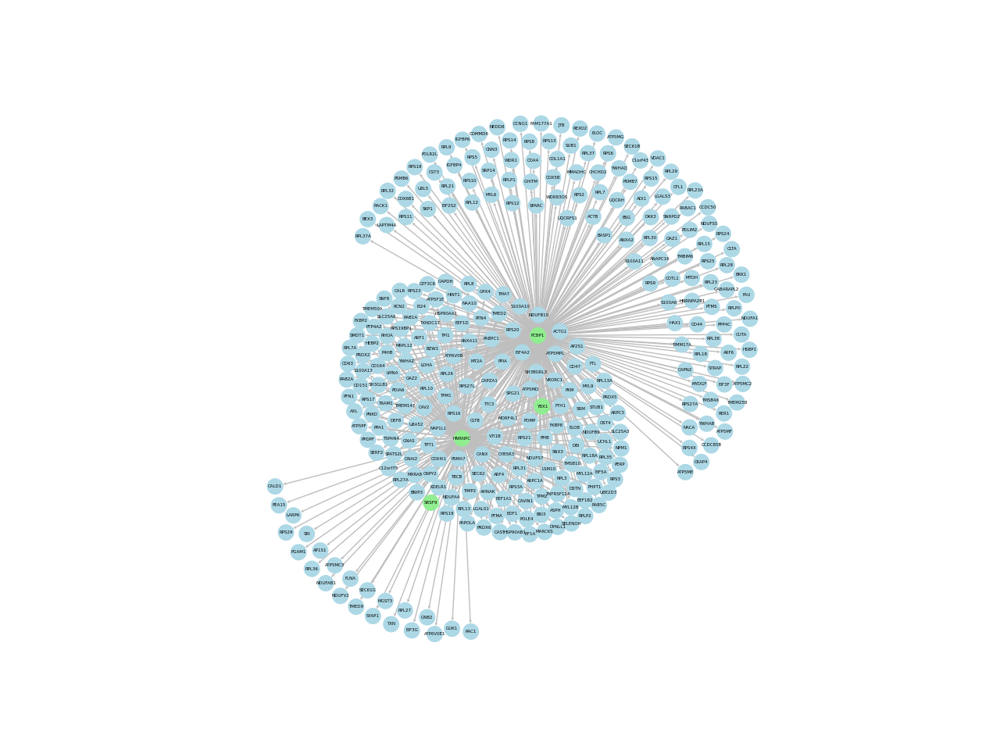

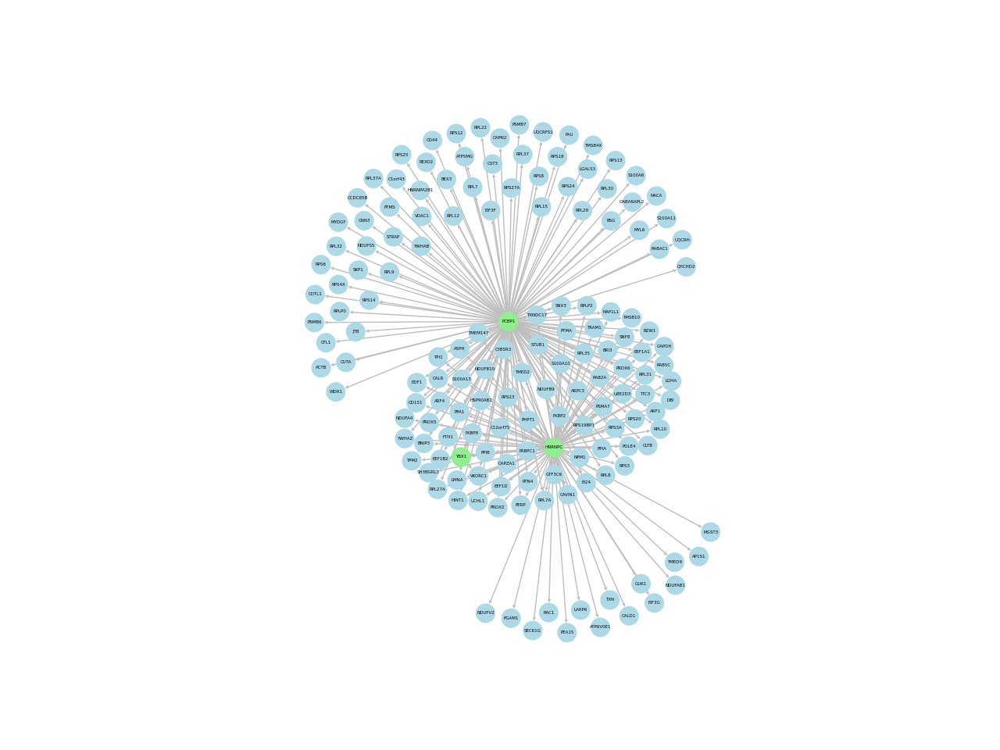

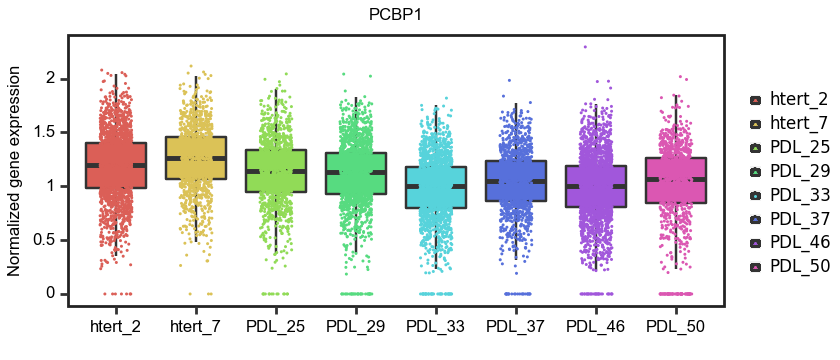

In [179]:
#violinplot for each stage

#umap of test dataset


from plotnine import *
import pandas as pd


black = '#222222'
gray = '#666666'
red = '#FF3333'
green = '#66CC00'
blue = '#3333FF'
purple = '#9933FF'
orange = '#FF8000'
yellow = '#FFFF33'
salmen = "#FA8072"
limegreen = '#32CD32'
deepskyblue = '#00AFEE'
c1="#F8766D"
c2="#00BA38"
c3="#619CFF"


meta_data["score_range"]=meta_data["PDL"]
meta_data["sen.score"]=meta_data_sene_score["sen.score"].to_list()


for i in meta_data.index:
    #test_meta_data.at[i,"score_range"]="b"
    senescence_score = meta_data.at[i,"sen.score"]

    if senescence_score<0.04:
        meta_data.at[i,"score_range"]="<0.04"
    elif senescence_score>=0.04 and senescence_score<=0.05:
        meta_data.at[i,"score_range"]="0.04-0.05"
    elif senescence_score>=0.05 and senescence_score<=0.06:
        meta_data.at[i,"score_range"]="0.05-0.06"
    elif senescence_score>=0.06 and senescence_score<=0.07:
        meta_data.at[i,"score_range"]="0.06-0.07"
    elif senescence_score>=0.07 and senescence_score<=0.08:
        meta_data.at[i,"score_range"]="0.07-0.08"
    elif senescence_score>=0.08 and senescence_score<=0.09:
        meta_data.at[i,"score_range"]="0.08-0.09"
    elif senescence_score>=0.09 and senescence_score<=0.10:
        meta_data.at[i,"score_range"]="0.09-0.10"
    elif senescence_score>=0.10:
        meta_data.at[i,"score_range"]=">0.10"

    



#embedding = data.obsm["X_umap"]

plot_data=data_rm_sparse.copy()        #copy to create a new object



plot_data["PDL"]=meta_data["PDL"].to_list()
plot_data["score_range"]=meta_data["score_range"].to_list()


gene="PCBP1"

#reorder 
plot_data['PDL'] = pd.Categorical(plot_data['PDL'], categories=['htert_2','htert_7','PDL_25', 'PDL_29', 'PDL_33', 'PDL_37', 'PDL_46', 'PDL_50'])

p =(ggplot()
    #+ geom_point(plot_data, aes(x='UMAP1', y='UMAP2', color="score"),size=0.001,stroke=0.3,alpha=1)
    +geom_boxplot(plot_data,aes(x="PDL", y=gene, fill="PDL"),outlier_shape="") 
    #+geom_violin(plot_data,aes(x="PDL",y="score")) 
    +geom_jitter(plot_data,aes(x="PDL", y=gene, fill="PDL",color="PDL"),width=0.2, height=0, alpha=1,size=0.01,stroke=0.3) 

    #+ geom_point(data_not_indrop, aes(x='UMAP1', y='UMAP2',color="factor(Technology)"),size=0.001,alpha=1)
    +theme(
            figure_size=[4.2,1.8],
            axis_text=element_text(size=6,family="Arial",color="black"),
            axis_title_x=element_text(size=6,family="Arial",color="black"),
            axis_title_y=element_text(size=6,family="Arial",color="black"),
            plot_title=element_text(margin={'b': 1, 'r': 0, 'units': 'pt'},size=6,family="Arial",color="black",hjust=0.5),
            panel_background=element_rect(fill=gray, alpha=0),
            panel_grid_major=element_line(size=0.3, alpha=0.0,color=black),
            panel_grid_minor=element_line(size=0.3, alpha=0.0,color=black),
            panel_border=element_rect(color=black, size=1),
            legend_title = element_text(size=6,alpha=0), #change legend title font size
            legend_text = element_text(size=6),
            legend_background=element_rect(size=0.5,alpha=0),
            #legend_position=(0.75,0.9), 
            legend_direction='vertical',
            #legend_position='right',
            legend_key_size=4) #change legend text font size))
        #+scale_color_manual(values =[c1, c2, c3]) 
        #+geom_density_2d(colour = "#F8766D",size=0.2,data=data_U,alpha=0.5)
        #+geom_density_2d(colour = "#00BA38",size=0.2,data=data_psU,alpha=0.5)
        +ggtitle(gene)
        #+scale_color_gradient(low=deepskyblue , high=yellow,mid=c2)
        #+scale_color_gradient(low=purple , high="yellow",mid=c2)
        #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
        #+scale_color_manual(values=['#66C2A4', '#B2DF8A', '#2CA25F'])  
        +labs(x="",y="Normalized gene expression")
    )
    #+ facet_wrap('G')
print(p)
p.save('figure/gene_expression_%s.pdf' % gene)



In [182]:
data_rm_sparse["EEF2"]

5.855048    1.552243
6.224709    1.981835
6.416493    1.456921
7.643942    1.745731
3.759016    2.729350
              ...   
5.546235    1.414507
6.873280    2.048980
6.287506    1.397292
7.528697    2.111442
5.644914    1.330738
Name: EEF2, Length: 12019, dtype: float32